In [1]:
# Standard library
import os
import sys
import re
import json
import pickle
import glob
import ast
import warnings
from pathlib import Path
import importlib

# Add custom path
sys.path.append('/root/capsule/code/beh_ephys_analysis')

# Scientific libraries
import numpy as np
import pandas as pd
import xarray as xr
import scipy.signal as signal
from scipy import stats
from statsmodels.stats.multitest import multipletests
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans

# Plotting
import matplotlib
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
import matplotlib.patches as patches
from matplotlib.lines import Line2D
from matplotlib.colors import LinearSegmentedColormap
from matplotlib import colormaps
from mpl_toolkits.axes_grid1.inset_locator import inset_axes

# SpikeInterface
import spikeinterface.full as si
import spikeinterface.extractors as se
import spikeinterface.preprocessing as spre
import spikeinterface.postprocessing as spost
import spikeinterface.widgets as sw

# Progress bar
from tqdm import tqdm

# IPython display
from IPython.display import clear_output

# Open Ephys
from open_ephys.analysis import Session

# AIND analysis and utils
from aind_dynamic_foraging_basic_analysis.licks.lick_analysis import load_nwb
from aind_dynamic_foraging_data_utils.nwb_utils import load_nwb_from_filename
from aind_ephys_utils import align, sort

# Local utilities
import utils.analysis_funcs as af
import utils.plotting_funcs as pf
from utils.beh_functions import session_dirs
# from utils.plot_utils import shiftedColorMap, template_reorder, plot_raster_bar, merge_pdfs

# Warnings
warnings.filterwarnings("ignore")

# Matplotlib inline for Jupyter
%matplotlib inline

# Confirm version
print(si.__version__)
print('Finished loading packages')


0.102.1
Finished loading packages


In [2]:
# combined_data_folder = '/data/combined/'
data_folder = '/root/capsule/data/LC-NE_scratch_data_06-14-2025/'
combined_unit_tbl_folder = os.path.join(data_folder, "combined/combine_unit_tbl")
combined_unit_pkl_file_path = os.path.join(combined_unit_tbl_folder, "combined_unit_tbl.pkl")

# Load the pickle file
unit_data = pd.read_pickle(combined_unit_pkl_file_path)

# If the data is not already a DataFrame, you can convert it
if not isinstance(unit_data, pd.DataFrame):
    unit_tbl = pd.DataFrame(unit_data)
else:
    unit_tbl = unit_data

opto_units = unit_tbl.query("opto_tagged == True & qc_pass == True")["unit"].to_list()
opto_unit_tbl = unit_tbl[(unit_tbl['opto_tagged'] == True) & (unit_tbl['qc_pass'] == True)]
opto_units = opto_unit_tbl['unit'].to_list()
print(f"Number of opto units: {len(opto_units)}")
# unit_tbl
header = unit_tbl.columns.tolist()
print(header)

Number of opto units: 420
['session', 'unit', 'qc_pass', 'opto_tagged', 'opto_tagging_pre', 'opto_tagging_post', 'anti', 'in_df', 'trial_count', 'p_max', 'lat_max_p', 'isi_violations', 'snr', 'eu', 'corr', 'probe', 'y_loc', 'rec_side', 'top', 'bottom']


In [9]:
import os
import re
import pandas as pd

## data organization for antidromic stimulation analysis
data_folder = '/root/capsule/data/LC-NE_scratch_data_06-14-2025'


# Regular expression to match the folder name pattern
pattern = re.compile(r'^(ecephys|behavior)_\d+_\d{4}-\d{2}-\d{2}_\d{2}-\d{2}-\d{2}$')
# Walk through the directory
data = []
for root, dirs, files in os.walk(data_folder):
    for dirname in dirs:
        if pattern.match(dirname):
            session = dirname
            session_id = "_".join(session.split("_")[:2])
            session_path = os.path.join(root, dirname)

            summary_filename = f"{session}_curated_soma_opto_tagging_summary.pkl"
            summary_path = os.path.join(session_path, "ephys", "opto", "curated", summary_filename)
            summary_exists = os.path.exists(summary_path)

            opto_session_filename = f"{session}_opto_session.csv" 
            opto_session_path = os.path.join(session_path, "ephys", "opto", "curated", opto_session_filename)            
            opto_session_exists = os.path.exists(opto_session_path)

            spiketimes_filename = f"spiketimes.pkl"
            spiketimes_path = os.path.join(session_path, "ephys", "curated", "processed", spiketimes_filename)
            spiketimes_exists = os.path.exists(spiketimes_path)          

            data.append({
                'session': session,
                'session_id': session_id,
                'session_path': session_path,
                'summary_file_path': summary_path,
                'summary_exists': summary_exists,
                'opto_session_file_path': opto_session_path,
                'opto_session_exists': opto_session_exists,                
                'spiketimes_file_path': spiketimes_path,
                'spiketimes_exists': spiketimes_exists,                
            })

# Create DataFrame
df = pd.DataFrame(data)
result_folder = '/scratch/antidromic'

# Display the DataFrame
df.to_csv(os.path.join(result_folder, 'session_summary.csv'), index=False)


In [67]:
# def find_behavior_folders(root_dir):
#     behavior_folders = []
#     for dirpath, dirnames, _ in os.walk(root_dir):
#         for dirname in dirnames:
#             if dirname.startswith("behavior_7") and not dirname.endswith(".nwb"):
#                 behavior_folders.append(dirname)
#     return behavior_folders
# import re


# ## Example usage:
# scratch_data_folder = '/root/capsule/data/LC-NE_scratch_data_04-25-2025'
# folders = find_behavior_folders(scratch_data_folder)
# # sort the folders by the number in the folder name
# folders.sort(key=lambda x: int(re.search(r'\d+', x).group()), reverse=True)
# print("Behavior folders:")

# for folder in folders:
#     print(folder)
# print(f"Number of behavior folders: {len(folders)}")

Behavior folders:
behavior_758017_2025-02-05_11-42-34
behavior_758017_2025-02-07_14-11-08
behavior_758017_2025-02-04_11-57-38
behavior_758017_2025-02-06_11-26-14
behavior_754897_2025-03-12_12-23-15
behavior_754897_2025-03-11_12-07-41
behavior_754897_2025-03-14_11-28-53
behavior_754897_2025-03-13_11-20-42
behavior_754897_2025-03-15_11-32-18
behavior_751769_2025-01-17_11-37-39
behavior_751769_2025-01-16_11-32-05
behavior_751769_2025-01-18_10-15-25
behavior_751766_2025-02-13_11-31-21
behavior_751766_2025-02-11_11-53-38
behavior_751766_2025-02-14_11-37-11
behavior_751766_2025-02-15_12-08-11
behavior_751181_2025-02-25_12-12-35
behavior_751181_2025-02-26_11-51-19
behavior_751181_2025-02-27_11-24-47
behavior_751004_2024-12-21_13-28-28
behavior_751004_2024-12-19_11-50-37
behavior_751004_2024-12-23_14-20-03
behavior_751004_2024-12-22_13-09-17
behavior_751004_2024-12-20_13-26-11
behavior_717121_2024-06-15_10-00-58
behavior_717121_2024-06-15_10-00-58
behavior_716325_2024-05-31_10-31-14
behavior_7

In [11]:
## No figure
result_folder = '/scratch/antidromic'
# Load the session summary CSV file
session_summary_path = os.path.join(result_folder, 'session_summary.csv')
session_summary_df = pd.read_csv(session_summary_path)
from scipy.stats import wilcoxon

def opto_tagging_response(int_event_locked_timestamps, base_window, roi_window):
    base_counts = []
    roi_counts = []

    for spike_times in int_event_locked_timestamps:
        if spike_times.size > 0:
            base_count = np.sum((spike_times >= base_window[0]) & (spike_times < base_window[1]))
            roi_count = np.sum((spike_times >= roi_window[0]) & (spike_times < roi_window[1]))
            base_counts.append(base_count)
            roi_counts.append(roi_count)

    base_counts = np.array(base_counts)
    roi_counts = np.array(roi_counts)

    # ✅ Only run test if we have at least 2 samples
    if len(base_counts) >= 2 and len(roi_counts) >= 2:
        try:
            stat, p_value = wilcoxon(base_counts, roi_counts)
            return p_value
        except ValueError:
            return np.nan
    else:
        return np.nan

    
def plot_opto_responses(unit_tbl, event_ids, spiketimes, session_id):
    results = []

    # Filter for opto tagged units
    opto_criteria = (unit_tbl['opto_pass'] == True) & (unit_tbl['default_qc'] == True)
    opto_units = unit_tbl[opto_criteria]["unit_id"].to_list()
    print(f"Session {session_id}: {len(opto_units)} opto-tagged units")

    
    # Unique values
    sites = list(np.unique(event_ids.emission_location))
    powers = list(np.unique(event_ids.power))
    trial_types = np.unique(event_ids.type)
    
    # Settings
    prepost = 'post'
    num_sites = len(sites)
    num_units = len(opto_units)

   
    # Loop through units
    for u_idx, unit_id in enumerate(opto_units):
        # if unit_id == 244:
        unit_spike_times = spiketimes[unit_id]

        for i, site in enumerate(sites):
            base_window = (-0.02, 0)
            roi_window = (0, 0.02) if site == 'surface_LC' else (0.03, 0.05)


            # Filter trials
            tag_trials = event_ids.query('site == @site and pre_post == @prepost')
            max_power = tag_trials.power.max()
            tag_trials = tag_trials.query('power == @max_power')
            if tag_trials.empty:
                continue

            # Stimulation parameters
            duration = np.unique(tag_trials.duration)[0]
            num_pulses = np.unique(tag_trials.num_pulses)[0]
            pulse_interval = np.unique(tag_trials.pulse_interval)[0]

            # Time window
            time_range_raster = np.array([-100 / 1000, 70 / 1000])
            this_event_timestamps = tag_trials.time.tolist()

            int_event_locked_timestamps = []
            pulse_nums = []

            for pulse_num in range(num_pulses):
                time_shift = pulse_num * (duration + pulse_interval) / 1000
                this_time_range = time_range_raster + time_shift

                this_locked = af.event_locked_timestamps(
                    unit_spike_times, this_event_timestamps, this_time_range, time_shift=time_shift
                )
                int_event_locked_timestamps.extend(this_locked)
                pulse_nums.extend([pulse_num + 1] * len(this_locked))

            # Perform significance test
            if len(int_event_locked_timestamps) != 0:
                p_val = opto_tagging_response(int_event_locked_timestamps, base_window, roi_window)
            if not np.isnan(p_val):
                results.append({
                    'unit_id': unit_id,
                    'site': site,
                    'p_value': round(p_val, 3)
                })
    return results



# ---- Main loop: compute opto response stats ----
all_opto_stats = []
session_summary_df['opto_units'] = None


for index, row in session_summary_df.iterrows():
    session = row['session']
    session_id = row['session_id']
    session_path = row['session_path']
    summary_file_path = row['summary_file_path']
    summary_exists = row['summary_exists']
    opto_session_file_path = row['opto_session_file_path'] 
    opto_session_exists = row['opto_session_exists']               
    spiketimes_file_path = row['spiketimes_file_path']
    spiketimes_exists = row['spiketimes_exists']

    if summary_exists and opto_session_exists and spiketimes_exists:
        print(f"Processing session: {session}")
        # Load the summary file
        unit_tbl = pd.read_pickle(summary_file_path)
        # print(f"Loaded summary file for {session}")
        # Load the opto session file
        event_ids = pd.read_csv(opto_session_file_path)
        # print(f"Loaded opto session file for {session}")
        # Load the spiketimes file
        with open(spiketimes_file_path, 'rb') as f:
            spiketimes = pickle.load(f)        

        # Filter for opto tagged units
        opto_criteria = (unit_tbl['opto_pass'] == True) & (unit_tbl['default_qc'] == True)
        opto_units = unit_tbl[opto_criteria]["unit_id"].to_list()
        # add opto_units to session_summary_df
        session_summary_df.at[index, 'opto_units'] = opto_units

        # Collect per-session result
        opto_stats = plot_opto_responses(unit_tbl, event_ids, spiketimes, session_id)
        all_opto_stats.append(opto_stats)
    else:
        all_opto_stats.append([])  # For missing files, add empty list

# Add full stats to DataFrame
session_summary_df['opto_unit_stats'] = all_opto_stats

from collections import defaultdict

# First, get all unique site names across all sessions
all_sites = set()
for stats in all_opto_stats:
    for entry in stats:
        all_sites.add(entry['site'])

# Initialize new columns in the DataFrame
for site in all_sites:
    col_name = f"sig_units_{site}"
    session_summary_df[col_name] = [[] for _ in range(len(session_summary_df))]

# Populate those columns with unit_ids that have p < 0.05
for i, stats in enumerate(session_summary_df['opto_unit_stats']):
    site_to_units = defaultdict(list)
    for entry in stats:
        if entry['p_value'] < 0.05:
            site_to_units[entry['site']].append(entry['unit_id'])

    # Assign to columns
    for site in all_sites:
        col_name = f"sig_units_{site}"
        session_summary_df.at[i, col_name] = site_to_units.get(site, [])

Processing session: behavior_751766_2025-02-13_11-31-21
Session behavior_751766: 10 opto-tagged units
Processing session: behavior_751766_2025-02-11_11-53-38
Session behavior_751766: 21 opto-tagged units
Processing session: behavior_751766_2025-02-14_11-37-11
Session behavior_751766: 12 opto-tagged units
Processing session: behavior_754897_2025-03-12_12-23-15
Session behavior_754897: 5 opto-tagged units
Processing session: behavior_754897_2025-03-11_12-07-41
Session behavior_754897: 3 opto-tagged units
Processing session: behavior_754897_2025-03-14_11-28-53
Session behavior_754897: 20 opto-tagged units
Processing session: behavior_754897_2025-03-13_11-20-42
Session behavior_754897: 31 opto-tagged units
Processing session: behavior_754897_2025-03-15_11-32-18
Session behavior_754897: 0 opto-tagged units
Processing session: behavior_716325_2024-05-31_10-31-14
Session behavior_716325: 13 opto-tagged units
Processing session: ecephys_691893_2023-10-05_12-46-57
Session ecephys_691893: 42 opt

In [136]:
# save 
session_summary_df.to_csv(os.path.join(result_folder, 'session_summary_with_opto_stats.csv'), index=False)

In [13]:
session_summary_df

,session,session_id,session_path,summary_file_path,summary_exists,opto_session_file_path,opto_session_exists,spiketimes_file_path,spiketimes_exists
0,behavior_751766_2025-02-13_11-31-21,behavior_751766,/root/capsule/data/LC-NE_scratch_data_06-14-20...,/root/capsule/data/LC-NE_scratch_data_06-14-20...,True,/root/capsule/data/LC-NE_scratch_data_06-14-20...,True,/root/capsule/data/LC-NE_scratch_data_06-14-20...,True
1,behavior_751766_2025-02-11_11-53-38,behavior_751766,/root/capsule/data/LC-NE_scratch_data_06-14-20...,/root/capsule/data/LC-NE_scratch_data_06-14-20...,True,/root/capsule/data/LC-NE_scratch_data_06-14-20...,True,/root/capsule/data/LC-NE_scratch_data_06-14-20...,True
2,behavior_751766_2025-02-14_11-37-11,behavior_751766,/root/capsule/data/LC-NE_scratch_data_06-14-20...,/root/capsule/data/LC-NE_scratch_data_06-14-20...,True,/root/capsule/data/LC-NE_scratch_data_06-14-20...,True,/root/capsule/data/LC-NE_scratch_data_06-14-20...,True
3,behavior_751766_2025-02-15_12-08-11,behavior_751766,/root/capsule/data/LC-NE_scratch_data_06-14-20...,/root/capsule/data/LC-NE_scratch_data_06-14-20...,False,/root/capsule/data/LC-NE_scratch_data_06-14-20...,False,/root/capsule/data/LC-NE_scratch_data_06-14-20...,False
4,behavior_754897_2025-03-12_12-23-15,behavior_754897,/root/capsule/data/LC-NE_scratch_data_06-14-20...,/root/capsule/data/LC-NE_scratch_data_06-14-20...,True,/root/capsule/data/LC-NE_scratch_data_06-14-20...,True,/root/capsule/data/LC-NE_scratch_data_06-14-20...,True
5,behavior_754897_2025-03-11_12-07-41,behavior_754897,/root/capsule/data/LC-NE_scratch_data_06-14-20...,/root/capsule/data/LC-NE_scratch_data_06-14-20...,True,/root/capsule/data/LC-NE_scratch_data_06-14-20...,True,/root/capsule/data/LC-NE_scratch_data_06-14-20...,True
6,behavior_754897_2025-03-14_11-28-53,behavior_754897,/root/capsule/data/LC-NE_scratch_data_06-14-20...,/root/capsule/data/LC-NE_scratch_data_06-14-20...,True,/root/capsule/data/LC-NE_scratch_data_06-14-20...,True,/root/capsule/data/LC-NE_scratch_data_06-14-20...,True
7,behavior_754897_2025-03-13_11-20-42,behavior_754897,/root/capsule/data/LC-NE_scratch_data_06-14-20...,/root/capsule/data/LC-NE_scratch_data_06-14-20...,True,/root/capsule/data/LC-NE_scratch_data_06-14-20...,True,/root/capsule/data/LC-NE_scratch_data_06-14-20...,True
8,behavior_754897_2025-03-15_11-32-18,behavior_754897,/root/capsule/data/LC-NE_scratch_data_06-14-20...,/root/capsule/data/LC-NE_scratch_data_06-14-20...,True,/root/capsule/data/LC-NE_scratch_data_06-14-20...,True,/root/capsule/data/LC-NE_scratch_data_06-14-20...,True
9,behavior_716325_2024-05-31_10-31-14,behavior_716325,/root/capsule/data/LC-NE_scratch_data_06-14-20...,/root/capsule/data/LC-NE_scratch_data_06-14-20...,True,/root/capsule/data/LC-NE_scratch_data_06-14-20...,True,/root/capsule/data/LC-NE_scratch_data_06-14-20...,True


Skipping behavior_751766_2025-02-13_11-31-21 — PDF already exists at /scratch/antidromic/behavior_751766_2025-02-13_11-31-21_antidromic_raster_summary_v2.pdf
Skipping behavior_751766_2025-02-11_11-53-38 — PDF already exists at /scratch/antidromic/behavior_751766_2025-02-11_11-53-38_antidromic_raster_summary_v2.pdf
Skipping behavior_751766_2025-02-14_11-37-11 — PDF already exists at /scratch/antidromic/behavior_751766_2025-02-14_11-37-11_antidromic_raster_summary_v2.pdf
Skipping behavior_754897_2025-03-12_12-23-15 — PDF already exists at /scratch/antidromic/behavior_754897_2025-03-12_12-23-15_antidromic_raster_summary_v2.pdf
Skipping behavior_754897_2025-03-11_12-07-41 — PDF already exists at /scratch/antidromic/behavior_754897_2025-03-11_12-07-41_antidromic_raster_summary_v2.pdf
Skipping behavior_754897_2025-03-14_11-28-53 — PDF already exists at /scratch/antidromic/behavior_754897_2025-03-14_11-28-53_antidromic_raster_summary_v2.pdf
Skipping behavior_754897_2025-03-13_11-20-42 — PDF a

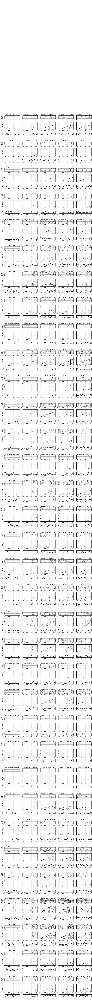

Saved figure to /scratch/antidromic/behavior_761038_2025-04-16_10-39-10_antidromic_raster_summary_v2.pdf
Processing session: behavior_761038_2025-04-18_12-37-39
Number of opto units: 15


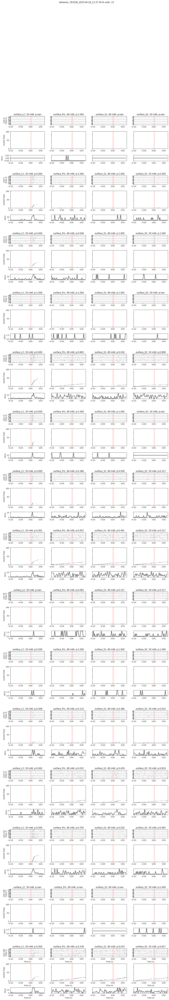

Saved figure to /scratch/antidromic/behavior_761038_2025-04-18_12-37-39_antidromic_raster_summary_v2.pdf
Processing session: behavior_761038_2025-04-17_11-03-16
Number of opto units: 3


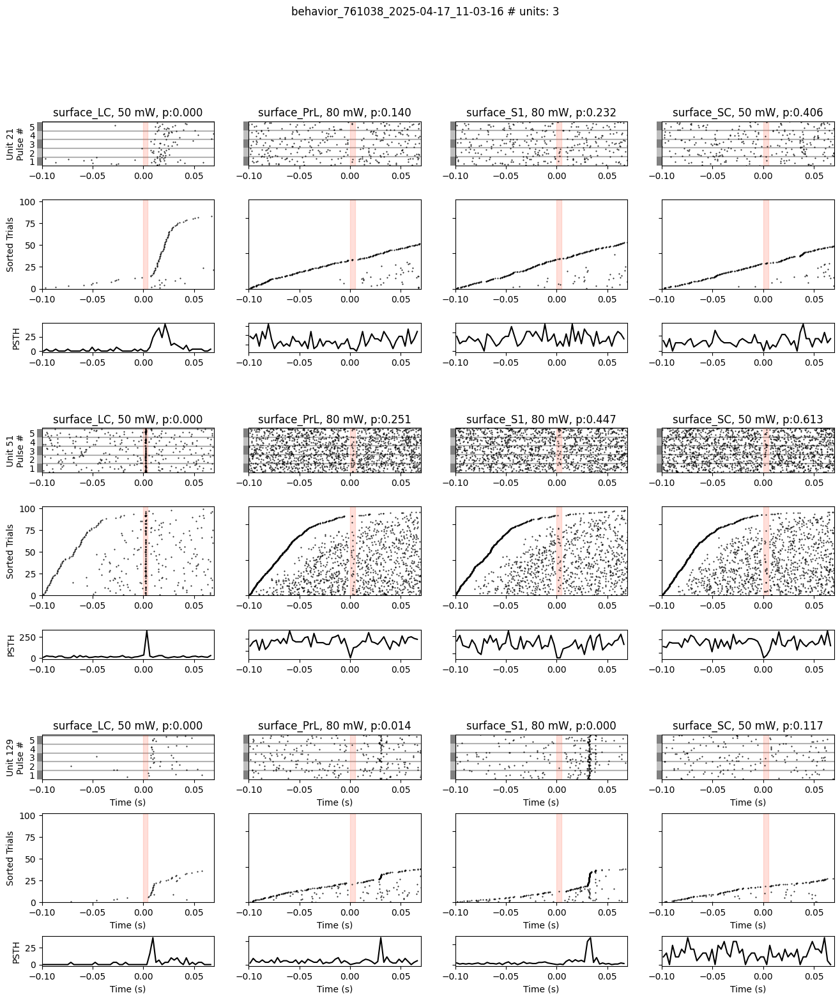

Saved figure to /scratch/antidromic/behavior_761038_2025-04-17_11-03-16_antidromic_raster_summary_v2.pdf
Processing session: behavior_761038_2025-04-15_10-25-11
Number of opto units: 22


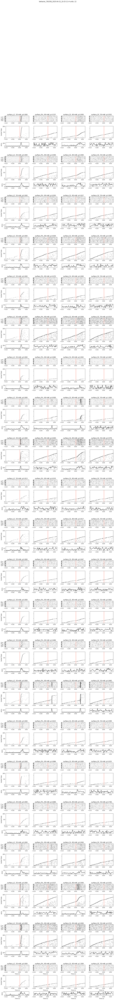

Saved figure to /scratch/antidromic/behavior_761038_2025-04-15_10-25-11_antidromic_raster_summary_v2.pdf
Skipping behavior_758018_2025-03-21_11-00-34 — PDF already exists at /scratch/antidromic/behavior_758018_2025-03-21_11-00-34_antidromic_raster_summary_v2.pdf
Processing session: behavior_758018_2025-03-19_11-16-44
Number of opto units: 18


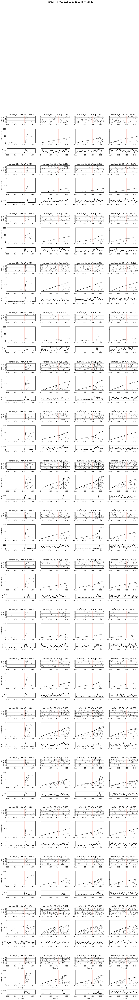

Saved figure to /scratch/antidromic/behavior_758018_2025-03-19_11-16-44_antidromic_raster_summary_v2.pdf
Processing session: behavior_758018_2025-03-20_11-53-05
Number of opto units: 8


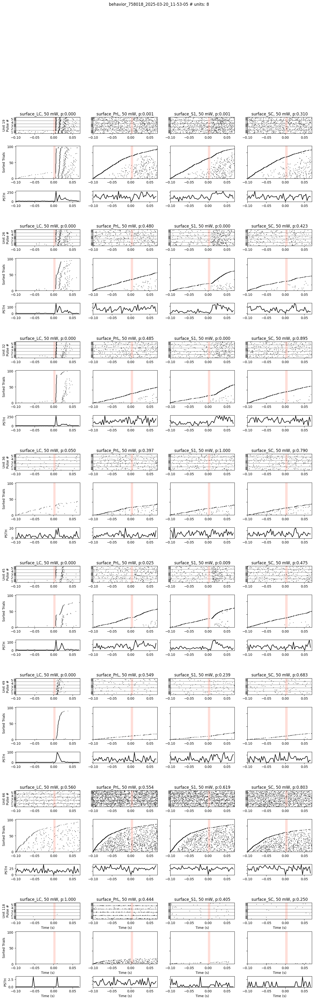

Saved figure to /scratch/antidromic/behavior_758018_2025-03-20_11-53-05_antidromic_raster_summary_v2.pdf
Skipping behavior_751769_2025-01-17_11-37-39 — PDF already exists at /scratch/antidromic/behavior_751769_2025-01-17_11-37-39_antidromic_raster_summary_v2.pdf
Skipping behavior_751769_2025-01-16_11-32-05 — PDF already exists at /scratch/antidromic/behavior_751769_2025-01-16_11-32-05_antidromic_raster_summary_v2.pdf
Skipping behavior_751769_2025-01-18_10-15-25 — PDF already exists at /scratch/antidromic/behavior_751769_2025-01-18_10-15-25_antidromic_raster_summary_v2.pdf
Processing session: behavior_752014_2025-03-28_11-04-59
Number of opto units: 7


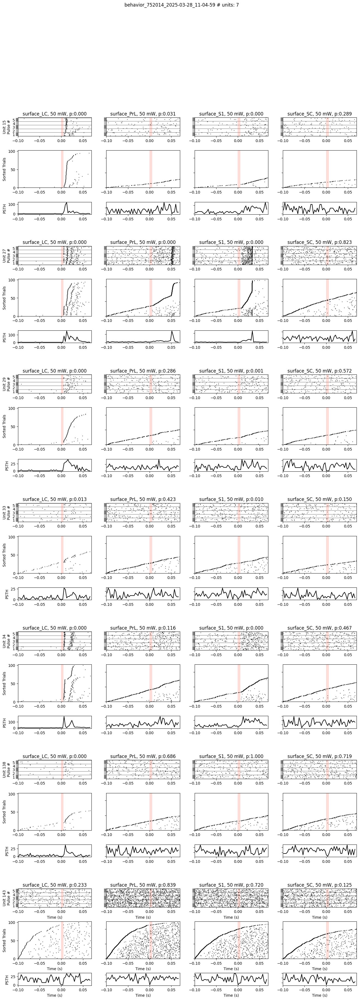

Saved figure to /scratch/antidromic/behavior_752014_2025-03-28_11-04-59_antidromic_raster_summary_v2.pdf
Processing session: behavior_752014_2025-03-25_12-09-20
Number of opto units: 4


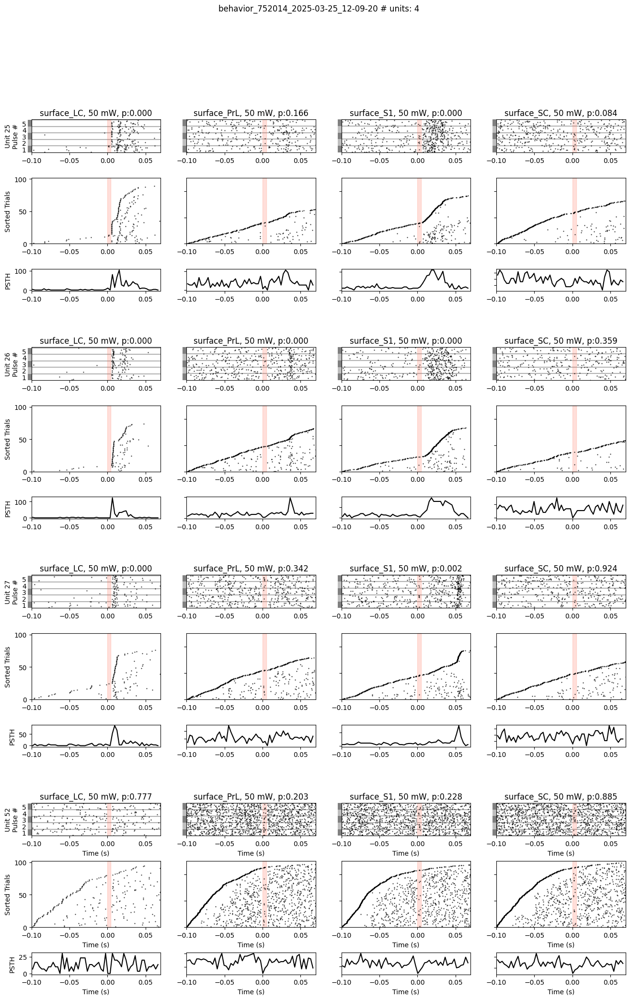

Saved figure to /scratch/antidromic/behavior_752014_2025-03-25_12-09-20_antidromic_raster_summary_v2.pdf
Processing session: behavior_752014_2025-03-27_12-03-59
No opto units found for session behavior_752014_2025-03-27_12-03-59
Processing session: behavior_752014_2025-03-26_11-18-57
Number of opto units: 3


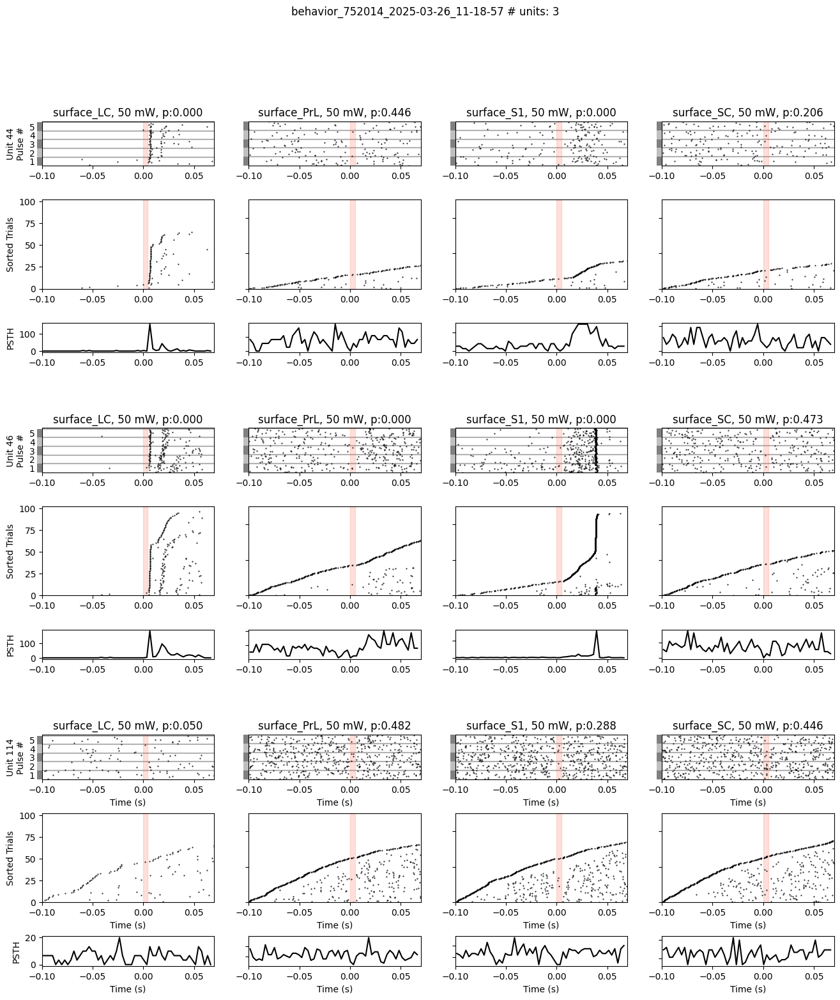

Saved figure to /scratch/antidromic/behavior_752014_2025-03-26_11-18-57_antidromic_raster_summary_v2.pdf
Skipping behavior_717121_2024-06-15_10-00-58 — PDF already exists at /scratch/antidromic/behavior_717121_2024-06-15_10-00-58_antidromic_raster_summary_v2.pdf
Skipping ecephys_687697_2023-09-15_11-30-06 — PDF already exists at /scratch/antidromic/ecephys_687697_2023-09-15_11-30-06_antidromic_raster_summary_v2.pdf
Skipping ecephys_687697_2023-09-15_12-36-06 — PDF already exists at /scratch/antidromic/ecephys_687697_2023-09-15_12-36-06_antidromic_raster_summary_v2.pdf
Skipping behavior_751181_2025-02-25_12-12-35 — PDF already exists at /scratch/antidromic/behavior_751181_2025-02-25_12-12-35_antidromic_raster_summary_v2.pdf
Skipping behavior_751181_2025-02-26_11-51-19 — PDF already exists at /scratch/antidromic/behavior_751181_2025-02-26_11-51-19_antidromic_raster_summary_v2.pdf
Skipping behavior_751181_2025-02-27_11-24-47 — PDF already exists at /scratch/antidromic/behavior_751181_2025

In [15]:
## Generate Figures
from ttictoc import tic,toc

result_folder = '/scratch/antidromic'
# Load the session summary CSV file
session_summary_path = os.path.join(result_folder, 'session_summary.csv')
session_summary_df = pd.read_csv(session_summary_path)
from scipy.stats import wilcoxon

def opto_tagging_response(int_event_locked_timestamps, base_window, roi_window):
    base_counts = []
    roi_counts = []

    for spike_times in int_event_locked_timestamps:
        if spike_times.size > 0:
            base_count = np.sum((spike_times >= base_window[0]) & (spike_times < base_window[1]))
            roi_count = np.sum((spike_times >= roi_window[0]) & (spike_times < roi_window[1]))
            base_counts.append(base_count)
            roi_counts.append(roi_count)

    base_counts = np.array(base_counts)
    roi_counts = np.array(roi_counts)

    # ✅ Only run test if we have at least 2 samples
    if len(base_counts) >= 2 and len(roi_counts) >= 2:
        try:
            stat, p_value = wilcoxon(base_counts, roi_counts)
            return p_value
        except ValueError:
            return np.nan
    else:
        return np.nan
    
def plot_opto_responses(unit_tbl, event_ids, spiketimes, session_id):
    """
    Find antidromic units based on opto stimulation data.
    """
    # Filter for opto tagged units
    opto_criteria = (unit_tbl['opto_pass'] == True) & (unit_tbl['default_qc'] == True)
    opto_units = unit_tbl[opto_criteria]["unit_id"].to_list()
    print(f"Number of opto units: {len(opto_units)}")

    
    # Unique values
    sites = list(np.unique(event_ids.emission_location))
    powers = list(np.unique(event_ids.power))
    trial_types = np.unique(event_ids.type)

    
    # Settings
    prepost = 'post'
    num_sites = len(sites)
    num_units = len(opto_units)

    # Create one figure for all units × sites (3 rows per unit: raster + PSTH + antidromic raster)
    fig_height_per_unit = 6
    fig = plt.figure(figsize=(num_sites * 4, num_units * fig_height_per_unit))
    fig.suptitle(f'{session} # units: {num_units}')
    # fig.suptitle(f'{session} - Opto responses for {num_units} units', fontsize=16)
    gs = gridspec.GridSpec(4 * num_units, num_sites, height_ratios=[3, 6, 2, 0.5] * num_units, hspace=0.8)

    # Loop through units
    for u_idx, unit_id in enumerate(opto_units):
        # if unit_id == 244:
        unit_spike_times = spiketimes[unit_id]

        for i, site in enumerate(sites):
            if site == 'surface_LC':
                # Define windows
                base_window = (-0.02, 0)
                roi_window = (0, 0.02)    
            else:
                # Define windows
                base_window = (-0.02, 0)
                roi_window = (0.03, 0.05)    


            # Filter trials
            tag_trials = event_ids.query('site == @site and pre_post == @prepost')
            max_power = tag_trials.power.max()
            tag_trials = tag_trials.query('power == @max_power')
            if tag_trials.empty:
                continue

            # Stimulation parameters
            duration = np.unique(tag_trials.duration)[0]
            num_pulses = np.unique(tag_trials.num_pulses)[0]
            pulse_interval = np.unique(tag_trials.pulse_interval)[0]

            # Time window
            time_range_raster = np.array([-100 / 1000, 70 / 1000])
            this_event_timestamps = tag_trials.time.tolist()

            int_event_locked_timestamps = []
            pulse_nums = []

            for pulse_num in range(num_pulses):
                time_shift = pulse_num * (duration + pulse_interval) / 1000
                this_time_range = time_range_raster + time_shift

                this_locked = af.event_locked_timestamps(
                    unit_spike_times, this_event_timestamps, this_time_range, time_shift=time_shift
                )
                int_event_locked_timestamps.extend(this_locked)
                pulse_nums.extend([pulse_num + 1] * len(this_locked))

            # Raster plot
            ax_raster = fig.add_subplot(gs[4 * u_idx, i])
            pf.raster_plot(int_event_locked_timestamps, time_range_raster, cond_each_trial=pulse_nums, ms=100, ax=ax_raster)
            p_val = opto_tagging_response(int_event_locked_timestamps, base_window, roi_window)


            # Add laser pulse patch
            yLims = np.array(ax_raster.get_ylim())
            laser_color = 'tomato'
            rect = patches.Rectangle((0, yLims[0]), duration / 1000, yLims[1] - yLims[0],
                                    linewidth=1, edgecolor=laser_color, facecolor=laser_color,
                                    alpha=0.2, clip_on=True)
            ax_raster.add_patch(rect)

            # Raster axis settings
            if i == 0:
                ax_raster.set_ylabel(f'Unit {unit_id}\nPulse #')
            else:
                ax_raster.set_yticklabels([])

            ax_raster.set_xlim(time_range_raster)
            if u_idx == num_units - 1:
                ax_raster.set_xlabel('Time (s)')
            ax_raster.set_title(f'{site}, {max_power} mW, p:{p_val:.3f}')


            # Add laser pulse aligned but sorted by spike times
            # Antidromic raster plot
            ax_antidromic = fig.add_subplot(gs[4 * u_idx + 1, i], sharex=ax_raster)
            sorted_data = sorted(int_event_locked_timestamps, key=lambda x: (len(x) == 0, x[0] if len(x) > 0 else np.inf))
            pf.raster_plot(sorted_data, time_range_raster)
            # pf.raster_plot(sorted_data, time_range_raster, ax=ax_antidromic)

            yLims = np.array(ax_antidromic.get_ylim())
            rect = patches.Rectangle((0, yLims[0]), duration / 1000, yLims[1] - yLims[0],
                                    linewidth=1, edgecolor='tomato', facecolor='tomato',
                                    alpha=0.2, clip_on=False)
            ax_antidromic.add_patch(rect)

            ax_antidromic.set_xlim(time_range_raster)
            if u_idx == num_units - 1:
                ax_antidromic.set_xlabel('Time (s)')

            if i == 0:
                ax_antidromic.set_ylabel('Sorted Trials')
            else:
                ax_antidromic.set_yticklabels([])

            # PSTH plot
            ax_psth = fig.add_subplot(gs[4 * u_idx + 2, i], sharex=ax_raster)
            psth, _, bins = pf.psth(int_event_locked_timestamps, time_range_raster, bin_size=0.003, smooth_window_size=3)
            ax_psth.plot(bins, psth, color='k')
            if i == 0:
                ax_psth.set_ylabel('PSTH')
            else:
                ax_psth.set_yticklabels([])
            ax_psth.set_xlim(time_range_raster)
            if u_idx == num_units - 1:
                ax_psth.set_xlabel('Time (s)')

    # Final layout adjustments
    fig.tight_layout(rect=[0, 0.03, 1, 0.95])    
    plt.show()

    return fig

    
for index, row in session_summary_df.iterrows():
    session = row['session']
    session_id = row['session_id']
    session_path = row['session_path']
    summary_file_path = row['summary_file_path']
    summary_exists = row['summary_exists']
    opto_session_file_path = row['opto_session_file_path'] 
    opto_session_exists = row['opto_session_exists']               
    spiketimes_file_path = row['spiketimes_file_path']
    spiketimes_exists = row['spiketimes_exists']


    output_pdf_path = os.path.join(result_folder, f'{session}_antidromic_raster_summary_v2.pdf')
    if os.path.exists(output_pdf_path):
        print(f"Skipping {session} — PDF already exists at {output_pdf_path}")
        continue
    else:
       if summary_exists and opto_session_exists and spiketimes_exists:
            print(f"Processing session: {session}")
            # Load the summary file
            unit_tbl = pd.read_pickle(summary_file_path)
            # print(f"Loaded summary file for {session}")
            # Load the opto session file
            event_ids = pd.read_csv(opto_session_file_path)
            # print(f"Loaded opto session file for {session}")
            # Load the spiketimes file
            with open(spiketimes_file_path, 'rb') as f:
                spiketimes = pickle.load(f)      
        
            # tic()
            # Filter for opto tagged units
            opto_criteria = (unit_tbl['opto_pass'] == True) & (unit_tbl['default_qc'] == True)
            opto_units = unit_tbl[opto_criteria]["unit_id"].to_list()
            if len(opto_units) == 0:
                print(f"No opto units found for session {session}")
                continue
            fig = plot_opto_responses(unit_tbl, event_ids, spiketimes, session_id)
            # print(toc())

            # # Save figure as pdf
            fig.savefig(output_pdf_path, bbox_inches='tight')   
            print(f'Saved figure to {output_pdf_path}')  






subject id:  758017
session:  behavior_758017_2025-02-05_11-42-34
Loading opto tagging data
opto_units:  [21, 37, 39, 128, 163, 166]
Loading spiketimes
Saved figure to /scratch/antidromic/behavior_758017_2025-02-05_11-42-34_antidromic_raster_summary.pdf
subject id:  758017
session:  behavior_758017_2025-02-07_14-11-08
Loading opto tagging data
opto_units:  [15, 17, 22, 23, 28, 30, 31, 44]
Loading spiketimes
Saved figure to /scratch/antidromic/behavior_758017_2025-02-07_14-11-08_antidromic_raster_summary.pdf
subject id:  758017
session:  behavior_758017_2025-02-04_11-57-38
Loading opto tagging data
opto_units:  [2, 5, 12, 14, 15, 19, 45, 130, 142, 164, 194, 195, 196, 197, 198, 199, 202]
Loading spiketimes
Saved figure to /scratch/antidromic/behavior_758017_2025-02-04_11-57-38_antidromic_raster_summary.pdf
subject id:  758017
session:  behavior_758017_2025-02-06_11-26-14
Loading opto tagging data
opto_units:  [73, 85, 134]
Loading spiketimes
Saved figure to /scratch/antidromic/behavior_7

ValueError: Number of rows must be a positive integer, not 0

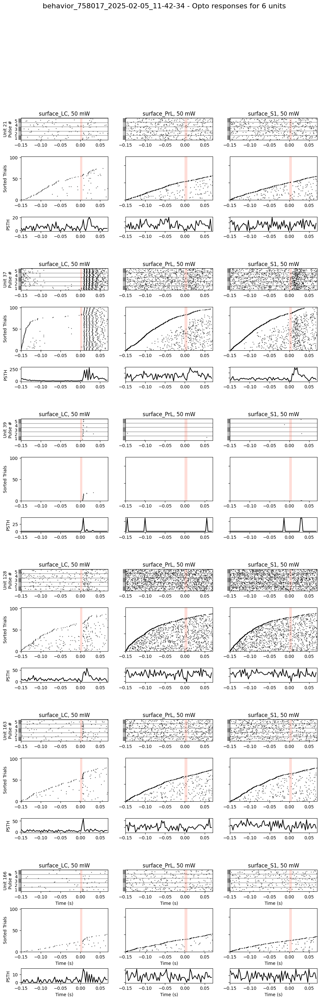

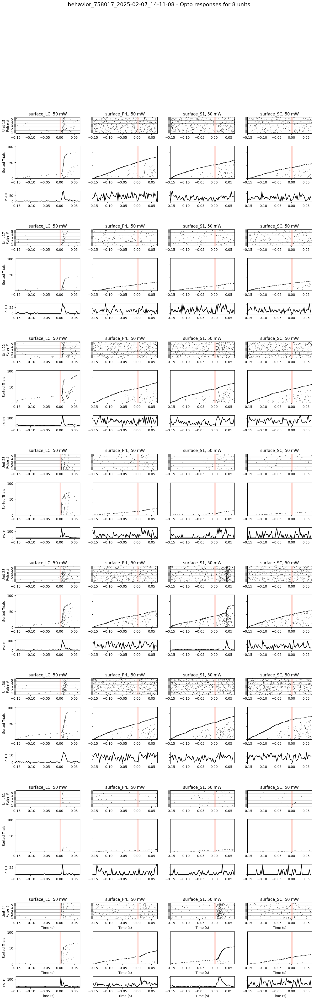

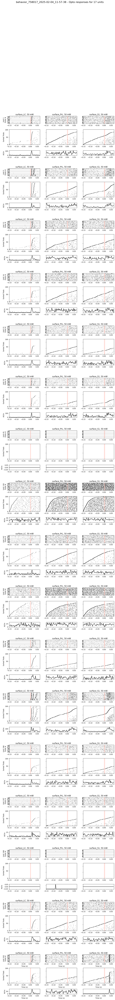

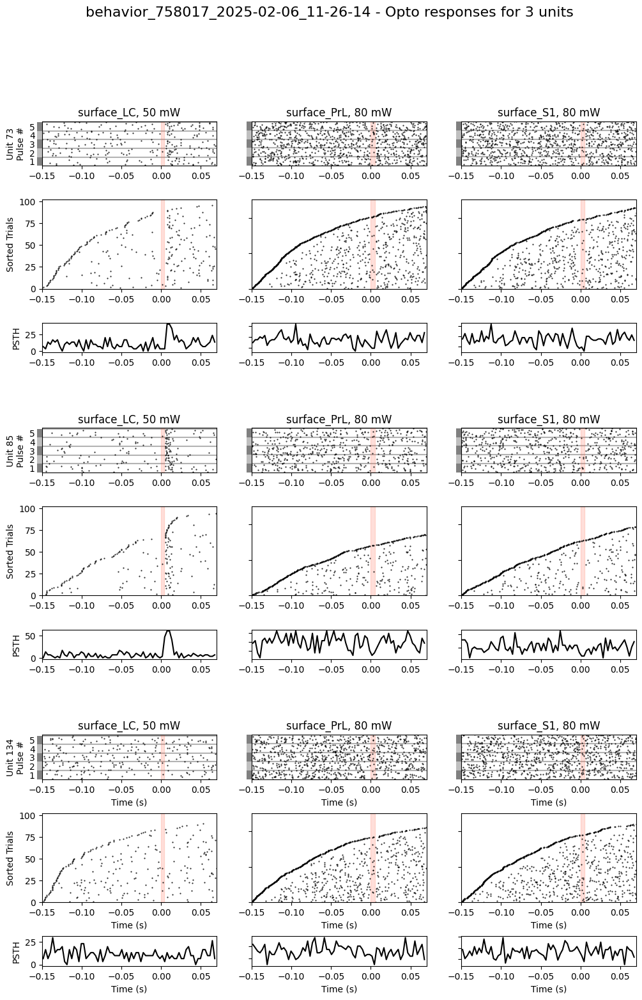

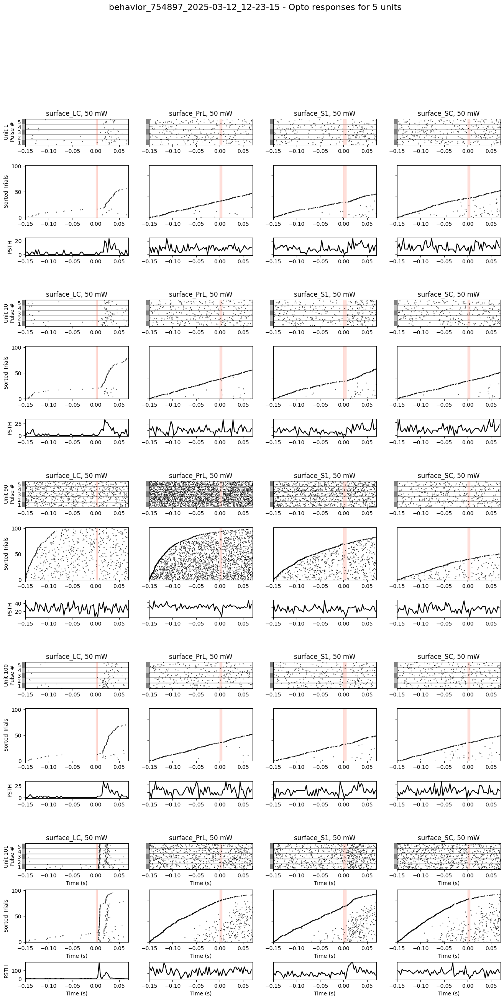

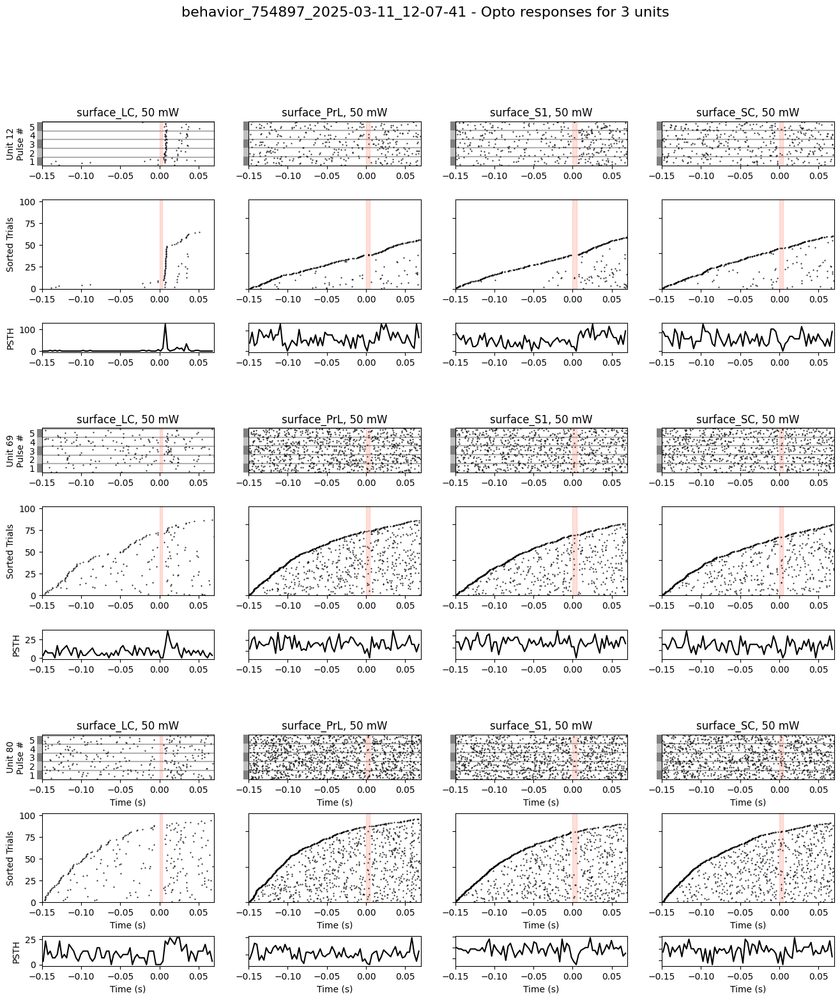

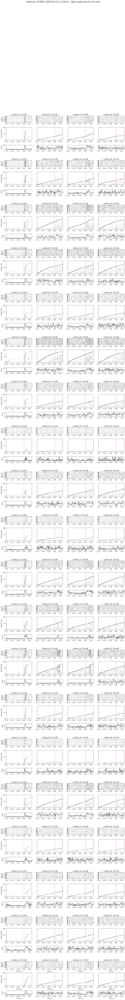

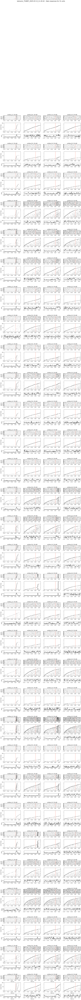

<Figure size 1600x0 with 0 Axes>

In [62]:
# ROI_session = ['behavior_751181_2025-02-27_11-24-47']
for session in folders:
    # if session in ROI_session:        
    if session in processed_session_id:
        print(f'{session} already processed')        
    else:
        subject_id = session.split('_')[1]
        print("subject id: ", subject_id)
        print("session: ", session)
        # session_dir = session_dirs(session)
        
        
        # load opto tagging data
        data_type = 'curated'
        target = 'soma'

        data_folder = f'{scratch_data_folder}/{subject_id}/{session}/ephys/opto/curated'
        print("Loading opto tagging data")

        try: 
            with open(os.path.join(data_folder, f'{session}_curated_soma_opto_tagging_summary.pkl'), 'rb') as f:            
                unit_tbl = pickle.load(f)
        except Exception as e:
            print(f"Skipping {os.path.join(data_folder, f'{session}_curated_soma_opto_tagging_summary.pkl')} due to error: {e}")
            continue
        
        opto_units = unit_tbl.query("opto_pass == True & default_qc == True")["unit_id"].to_list()
        print("opto_units: ", opto_units)
        ## Load spike times

        print("Loading spiketimes")
        # session_dir = session_dirs(session)
        data_type = 'curated'

        try:
            with open(os.path.join(f'{scratch_data_folder}/{subject_id}/{session}/ephys/curated/processed', 'spiketimes.pkl'), 'rb') as f:
                spiketimes = pickle.load(f)
        except Exception as e:
            print(f"Skipping {os.path.join(data_folder, 'spiketimes.pkl')} due to error: {e}")
            continue

        start = np.min(np.array([np.min(spiketimes[unit]) for unit in spiketimes.keys()]))
        end = np.max(np.array([np.max(spiketimes[unit]) for unit in spiketimes.keys()]))
        # Load opto event data
        opto_event_file = Path(f'{data_folder}/{session}_opto_session.csv')
        event_ids = pd.read_csv(opto_event_file)

        # Unique values
        sites = list(np.unique(event_ids.emission_location))
        powers = list(np.unique(event_ids.power))
        trial_types = np.unique(event_ids.type)

        opto_units = opto_units  # Limit to first 2 units for demonstration
        # Settings
        prepost = 'post'
        num_sites = len(sites)
        num_units = len(opto_units)

        # Create one figure for all units × sites (3 rows per unit: raster + PSTH + antidromic raster)
        fig_height_per_unit = 6
        fig = plt.figure(figsize=(num_sites * 4, num_units * fig_height_per_unit))
        fig.suptitle(f'{session} - Opto responses for {num_units} units', fontsize=16)
        gs = gridspec.GridSpec(4 * num_units, num_sites, height_ratios=[3, 6, 2, 0.5] * num_units, hspace=0.8)

        # Loop through units
        for u_idx, unit_id in enumerate(opto_units):
            # if unit_id == 244:
            unit_spike_times = spiketimes[unit_id]

            for i, site in enumerate(sites):
                # Filter trials
                tag_trials = event_ids.query('site == @site and pre_post == @prepost')
                max_power = tag_trials.power.max()
                tag_trials = tag_trials.query('power == @max_power')
                if tag_trials.empty:
                    continue

                # Stimulation parameters
                duration = np.unique(tag_trials.duration)[0]
                num_pulses = np.unique(tag_trials.num_pulses)[0]
                pulse_interval = np.unique(tag_trials.pulse_interval)[0]

                # Time window
                time_range_raster = np.array([-150 / 1000, 70 / 1000])
                this_event_timestamps = tag_trials.time.tolist()

                int_event_locked_timestamps = []
                pulse_nums = []

                for pulse_num in range(num_pulses):
                    time_shift = pulse_num * (duration + pulse_interval) / 1000
                    this_time_range = time_range_raster + time_shift

                    this_locked = af.event_locked_timestamps(
                        unit_spike_times, this_event_timestamps, this_time_range, time_shift=time_shift
                    )
                    int_event_locked_timestamps.extend(this_locked)
                    pulse_nums.extend([pulse_num + 1] * len(this_locked))

                # Raster plot
                ax_raster = fig.add_subplot(gs[4 * u_idx, i])
                pf.raster_plot(int_event_locked_timestamps, time_range_raster, cond_each_trial=pulse_nums, ms=100, ax=ax_raster)

                # Add laser pulse patch
                yLims = np.array(ax_raster.get_ylim())
                laser_color = 'tomato'
                rect = patches.Rectangle((0, yLims[0]), duration / 1000, yLims[1] - yLims[0],
                                        linewidth=1, edgecolor=laser_color, facecolor=laser_color,
                                        alpha=0.2, clip_on=True)
                ax_raster.add_patch(rect)

                # Raster axis settings
                if i == 0:
                    ax_raster.set_ylabel(f'Unit {unit_id}\nPulse #')
                else:
                    ax_raster.set_yticklabels([])

                ax_raster.set_xlim(time_range_raster)
                if u_idx == num_units - 1:
                    ax_raster.set_xlabel('Time (s)')
                ax_raster.set_title(f'{site}, {max_power} mW')


                # Add laser pulse aligned but sorted by spike times
                # Antidromic raster plot
                ax_antidromic = fig.add_subplot(gs[4 * u_idx + 1, i], sharex=ax_raster)
                sorted_data = sorted(int_event_locked_timestamps, key=lambda x: (len(x) == 0, x[0] if len(x) > 0 else np.inf))
                pf.raster_plot(sorted_data, time_range_raster)
                # pf.raster_plot(sorted_data, time_range_raster, ax=ax_antidromic)

                yLims = np.array(ax_antidromic.get_ylim())
                rect = patches.Rectangle((0, yLims[0]), duration / 1000, yLims[1] - yLims[0],
                                        linewidth=1, edgecolor='tomato', facecolor='tomato',
                                        alpha=0.2, clip_on=False)
                ax_antidromic.add_patch(rect)

                ax_antidromic.set_xlim(time_range_raster)
                if u_idx == num_units - 1:
                    ax_antidromic.set_xlabel('Time (s)')

                if i == 0:
                    ax_antidromic.set_ylabel('Sorted Trials')
                else:
                    ax_antidromic.set_yticklabels([])

                # PSTH plot
                ax_psth = fig.add_subplot(gs[4 * u_idx + 2, i], sharex=ax_raster)
                psth, _, bins = pf.psth(int_event_locked_timestamps, time_range_raster, bin_size=0.003, smooth_window_size=3)
                ax_psth.plot(bins, psth, color='k')
                if i == 0:
                    ax_psth.set_ylabel('PSTH')
                else:
                    ax_psth.set_yticklabels([])
                ax_psth.set_xlim(time_range_raster)
                if u_idx == num_units - 1:
                    ax_psth.set_xlabel('Time (s)')
                        
                      

        # Final layout adjustments
        fig.tight_layout(rect=[0, 0.03, 1, 0.95])
    
        # Save figure as pdf
        fig.savefig(os.path.join(result_folder, f'{session}_antidromic_raster_summary.pdf'), bbox_inches='tight')   
        print(f'Saved figure to {result_folder}/{session}_antidromic_raster_summary.pdf')     

In [ ]:
ROI_session = ['behavior_751181_2025-02-27_11-24-47']
for session in folders:
    if session in ROI_session:        
        if session in processed_session_id:
            print(f'{session} already processed')        
        else:
            subject_id = session.split('_')[1]
            print("subject id: ", subject_id)
            print("session: ", session)
            # session_dir = session_dirs(session)
            
            
            # load opto tagging data
            data_type = 'curated'
            target = 'soma'


            data_folder = f'{scratch_data_folder}/{subject_id}/{session}/ephys/opto/curated'
            print("Loading opto tagging data")

            try: 
                with open(os.path.join(data_folder, f'{session}_curated_soma_opto_tagging_summary.pkl'), 'rb') as f:            
                    unit_tbl = pickle.load(f)
            except Exception as e:
                print(f"Skipping {os.path.join(data_folder, f'{session}_curated_soma_opto_tagging_summary.pkl')} due to error: {e}")
                continue
            
            opto_units = unit_tbl.query("opto_pass == True & default_qc == True")["unit_id"].to_list()
            print("opto_units: ", opto_units)
            ## Load spike times

            print("Loading spiketimes")
            # session_dir = session_dirs(session)
            data_type = 'curated'

            try:
                with open(os.path.join(f'{scratch_data_folder}/{subject_id}/{session}/ephys/curated/processed', 'spiketimes.pkl'), 'rb') as f:
                    spiketimes = pickle.load(f)
            except Exception as e:
                print(f"Skipping {os.path.join(data_folder, 'spiketimes.pkl')} due to error: {e}")
                continue

            start = np.min(np.array([np.min(spiketimes[unit]) for unit in spiketimes.keys()]))
            end = np.max(np.array([np.max(spiketimes[unit]) for unit in spiketimes.keys()]))
            # Load opto event data
            opto_event_file = Path(f'{data_folder}/{session}_opto_session.csv')
            event_ids = pd.read_csv(opto_event_file)

            # Unique values
            sites = list(np.unique(event_ids.emission_location))
            powers = list(np.unique(event_ids.power))
            trial_types = np.unique(event_ids.type)

            opto_units = opto_units  # Limit to first 2 units for demonstration
            # Settings
            prepost = 'post'
            num_sites = len(sites)
            num_units = len(opto_units)

            # Create one figure for all units × sites (3 rows per unit: raster + PSTH + antidromic raster)
            fig_height_per_unit = 6
            fig = plt.figure(figsize=(num_sites * 4, num_units * fig_height_per_unit))
            fig.suptitle(f'{session} - Opto responses for {num_units} units', fontsize=16)
            gs = gridspec.GridSpec(4 * num_units, num_sites, height_ratios=[3, 6, 2, 0.5] * num_units, hspace=0.8)

            # Loop through units
            for u_idx, unit_id in enumerate(opto_units):
                if unit_id == 57:
                    unit_spike_times = spiketimes[unit_id]

                    for i, site in enumerate(sites):
                        # Filter trials
                        tag_trials = event_ids.query('site == @site and pre_post == @prepost')
                        max_power = tag_trials.power.max()
                        tag_trials = tag_trials.query('power == @max_power')
                        if tag_trials.empty:
                            continue

                        # Stimulation parameters
                        duration = np.unique(tag_trials.duration)[0]
                        num_pulses = np.unique(tag_trials.num_pulses)[0]
                        pulse_interval = np.unique(tag_trials.pulse_interval)[0]

                        # Time window
                        time_range_raster = np.array([-150 / 1000, 70 / 1000])
                        this_event_timestamps = tag_trials.time.tolist()

                        int_event_locked_timestamps = []
                        pulse_nums = []

                        for pulse_num in range(num_pulses):
                            time_shift = pulse_num * (duration + pulse_interval) / 1000
                            this_time_range = time_range_raster + time_shift

                            this_locked = af.event_locked_timestamps(
                                unit_spike_times, this_event_timestamps, this_time_range, time_shift=time_shift
                            )
                            int_event_locked_timestamps.extend(this_locked)
                            pulse_nums.extend([pulse_num + 1] * len(this_locked))

                        # Raster plot
                        ax_raster = fig.add_subplot(gs[4 * u_idx, i])
                        pf.raster_plot(int_event_locked_timestamps, time_range_raster, cond_each_trial=pulse_nums, ms=100, ax=ax_raster)

                        # Add laser pulse patch
                        yLims = np.array(ax_raster.get_ylim())
                        laser_color = 'tomato'
                        rect = patches.Rectangle((0, yLims[0]), duration / 1000, yLims[1] - yLims[0],
                                                linewidth=1, edgecolor=laser_color, facecolor=laser_color,
                                                alpha=0.2, clip_on=True)
                        ax_raster.add_patch(rect)

                        # Raster axis settings
                        if i == 0:
                            ax_raster.set_ylabel(f'Unit {unit_id}\nPulse #')
                        else:
                            ax_raster.set_yticklabels([])

                        ax_raster.set_xlim(time_range_raster)
                        if u_idx == num_units - 1:
                            ax_raster.set_xlabel('Time (s)')
                        ax_raster.set_title(f'{site}, {max_power} mW')


                        # Add laser pulse aligned but sorted by spike times
                        # Antidromic raster plot
                        ax_antidromic = fig.add_subplot(gs[4 * u_idx + 1, i], sharex=ax_raster)
                        sorted_data = sorted(int_event_locked_timestamps, key=lambda x: (len(x) == 0, x[0] if len(x) > 0 else np.inf))
                        if i==2:
                            ROI_sorted_data = sorted_data 

                        pf.raster_plot(sorted_data, time_range_raster)
                        # pf.raster_plot(sorted_data, time_range_raster, ax=ax_antidromic)

                        yLims = np.array(ax_antidromic.get_ylim())
                        rect = patches.Rectangle((0, yLims[0]), duration / 1000, yLims[1] - yLims[0],
                                                linewidth=1, edgecolor='tomato', facecolor='tomato',
                                                alpha=0.2, clip_on=False)
                        ax_antidromic.add_patch(rect)

                        ax_antidromic.set_xlim(time_range_raster)
                        if u_idx == num_units - 1:
                            ax_antidromic.set_xlabel('Time (s)')

                        if i == 0:
                            ax_antidromic.set_ylabel('Sorted Trials')
                        else:
                            ax_antidromic.set_yticklabels([])

                        # PSTH plot
                        ax_psth = fig.add_subplot(gs[4 * u_idx + 2, i], sharex=ax_raster)
                        psth, _, bins = pf.psth(int_event_locked_timestamps, time_range_raster, bin_size=0.003, smooth_window_size=3)
                        ax_psth.plot(bins, psth, color='k')
                        if i == 0:
                            ax_psth.set_ylabel('PSTH')
                        else:
                            ax_psth.set_yticklabels([])
                        ax_psth.set_xlim(time_range_raster)
                        if u_idx == num_units - 1:
                            ax_psth.set_xlabel('Time (s)')                                              


[array([-0.14989289]),
 array([-0.14936938,  0.06845108]),
 array([-0.14912305]),
 array([-0.14872589]),
 array([-0.14872287]),
 array([-0.14842156, -0.08149046]),
 array([-0.14823404]),
 array([-0.14756883,  0.04893624]),
 array([-0.14732853]),
 array([-0.14721389]),
 array([-0.1463872]),
 array([-0.14588216]),
 array([-0.14510682]),
 array([-0.14419595]),
 array([-0.14278356]),
 array([-0.14249244, -0.07022577]),
 array([-0.14242286, -0.01069052]),
 array([-0.14194031]),
 array([-0.14172485]),
 array([-0.14141984]),
 array([-0.14114037, -0.05394037]),
 array([-0.14099088]),
 array([-0.14076032, -0.01093131]),
 array([-0.14074852, -0.00794852]),
 array([-0.1407209]),
 array([-0.14038942]),
 array([-0.14007929]),
 array([-0.13955435, -0.06922336, -0.0170251 ]),
 array([-0.13941275]),
 array([-0.13859218]),
 array([-0.13809977]),
 array([-0.1377007]),
 array([-0.13598251]),
 array([-0.13590331]),
 array([-0.13589314]),
 array([-0.13555891]),
 array([-0.13555741, -0.06439074]),
 array([-

In [16]:
# antidromic unit test
def antidromic_unit_test(sorted_data, spike_time_range = (20, 50), bin_num=100, plot=True):
    """
    Identify antidromic spikes based on first post-stimulus spike timing.

    Parameters:
    sorted_data (list of arrays): Spike times per trial.
    spike_time_range (tuple): Expected antidromic window (start, end) in milliseconds.
    bin_num (int): Number of bins for histogram plotting.
    plot (bool): Whether to plot histogram and results.

    Returns:
    dict: Dictionary with antidromic latency (s), antidromic probability, and first_post_stim_spike_times.
    """
    first_post_stim_spike_times = []
    
    for spike_times in sorted_data:
        if spike_times.size > 0 and np.any(spike_times > 0):
            first_spike = spike_times[spike_times > 0][0]
            first_post_stim_spike_times.append(first_spike)
            
        # Check if first spikes fall within the antidromic window
        is_antidromic_spike = (spike_times >= spike_time_range_sec[0]/1000) & \
                          (spike_times <= spike_time_range_sec[1]/1000)


    if not first_post_stim_spike_times:
        raise ValueError("No valid post-stimulus spikes found.")

    first_post_stim_spike_times = np.array(first_post_stim_spike_times)

    # Convert spike time range to seconds
    spike_time_range_sec = (spike_time_range[0] / 1000, spike_time_range[1] / 1000)

    

    # Calculate antidromic spike probability
    antidromic_spike_prob = np.sum(is_antidromic_spike) / len(first_post_stim_spike_times)

    # Find peak latency (for information only)
    hist, bin_edges = np.histogram(first_post_stim_spike_times, bins=bin_num)
    peak_x = bin_edges[np.argmax(hist)]
    antidromic_latency = peak_x

    # Optional plot
    if plot:
        plt.figure(figsize=(10, 6))
        plt.plot(bin_edges[:-1], hist, color='k')
        plt.axvline(antidromic_latency, color='r', linestyle='--', label=f'Peak: {antidromic_latency:.3f} s')
        plt.xlabel('First post-stimulus spike time (s)')
        plt.ylabel('Count')
        plt.title(f'Antidromic Test\nSpike Probability: {antidromic_spike_prob:.2f}')
        plt.legend()
        plt.grid(True)
        plt.show()

    return {
        'first_post_stim_spike_times': first_post_stim_spike_times,
        'antidromic_latency': antidromic_latency,
        'antidromic_spike_probability': antidromic_spike_prob,
        'num_trials': len(first_post_stim_spike_times),
        'num_antidromic_spikes': np.sum(is_antidromic_spike)
    }

    
    # for a, spike_times in enumerate(sorted_data):
    #     if spike_times.size > 0 and any(spike_times[spike_times > 0]):       
    #         first_post_stim_spike_times.append(spike_times[spike_times > 0][0])
        

        

    #     resp = 
            

    # peak_x = bin_edges[np.argmax(hist)]
    # antidromic_latency = peak_x
    
antidromic_spike_time_ranges = (20, 50)    
antidromic_unit_test(sorted_data, antidromic_spike_time_ranges , bin_num=100, plot=True)



# print(first_post_stim_spike_times)
# hist, bin_edges = np.histogram(first_post_stim_spike_times, bins=100)
# # plot histogram
# plt.figure(figsize=(10, 6))
# plt.plot(bin_edges[:-1], hist, color='k')
# plt.xlabel('First post-stimulus spike time (s)')
# plt.ylabel('Count')
# # find x-value for the peak 
# plt.axvline(peak_x, color='r', linestyle='--')
# plt.title(f'Peak first post-stimulus spike time: {peak_x:.3f} s') 



NameError: name 'sorted_data' is not defined

In [17]:
## Find antidromic unit without plotting
ROI_session = ['behavior_751181_2025-02-27_11-24-47']
for session in folders:
    if session in ROI_session:        
        if session in processed_session_id:
            print(f'{session} already processed')        
        else:
            subject_id = session.split('_')[1]
            print("subject id: ", subject_id)
            print("session: ", session)
            
            # load opto tagging data
            data_type = 'curated'
            target = 'soma'

            data_folder = f'{scratch_data_folder}/{subject_id}/{session}/ephys/opto/curated'
            print("Loading opto tagging data")

            try: 
                with open(os.path.join(data_folder, f'{session}_curated_soma_opto_tagging_summary.pkl'), 'rb') as f:            
                    unit_tbl = pickle.load(f)
            except Exception as e:
                print(f"Skipping {os.path.join(data_folder, f'{session}_curated_soma_opto_tagging_summary.pkl')} due to error: {e}")
                continue
            
            opto_units = unit_tbl.query("opto_pass == True & default_qc == True")["unit_id"].to_list()
            print("opto_units: ", opto_units)
            ## Load spike times

            print("Loading spiketimes")
            # session_dir = session_dirs(session)
            data_type = 'curated'

            try:
                with open(os.path.join(f'{scratch_data_folder}/{subject_id}/{session}/ephys/curated/processed', 'spiketimes.pkl'), 'rb') as f:
                    spiketimes = pickle.load(f)
            except Exception as e:
                print(f"Skipping {os.path.join(data_folder, 'spiketimes.pkl')} due to error: {e}")
                continue

            start = np.min(np.array([np.min(spiketimes[unit]) for unit in spiketimes.keys()]))
            end = np.max(np.array([np.max(spiketimes[unit]) for unit in spiketimes.keys()]))
            # Load opto event data
            opto_event_file = Path(f'{data_folder}/{session}_opto_session.csv')
            event_ids = pd.read_csv(opto_event_file)

            # Unique values
            sites = list(np.unique(event_ids.emission_location))
            powers = list(np.unique(event_ids.power))
            trial_types = np.unique(event_ids.type)

            opto_units = opto_units  # Limit to first 2 units for demonstration
            # Settings
            prepost = 'post'
            num_sites = len(sites)
            num_units = len(opto_units)

            # Create one figure for all units × sites (3 rows per unit: raster + PSTH + antidromic raster)
            fig_height_per_unit = 6
            fig = plt.figure(figsize=(num_sites * 4, num_units * fig_height_per_unit))
            fig.suptitle(f'{session} - Opto responses for {num_units} units', fontsize=16)
            gs = gridspec.GridSpec(4 * num_units, num_sites, height_ratios=[3, 6, 2, 0.5] * num_units, hspace=0.8)

            # Loop through units
            for u_idx, unit_id in enumerate(opto_units):
                if unit_id == 57:
                    unit_spike_times = spiketimes[unit_id]

                    for i, site in enumerate(sites):
                        # Filter trials
                        tag_trials = event_ids.query('site == @site and pre_post == @prepost')
                        max_power = tag_trials.power.max()
                        tag_trials = tag_trials.query('power == @max_power')
                        if tag_trials.empty:
                            continue

                        # Stimulation parameters
                        duration = np.unique(tag_trials.duration)[0]
                        num_pulses = np.unique(tag_trials.num_pulses)[0]
                        pulse_interval = np.unique(tag_trials.pulse_interval)[0]

                        # Time window
                        time_range_raster = np.array([-150 / 1000, 70 / 1000])
                        this_event_timestamps = tag_trials.time.tolist()

                        int_event_locked_timestamps = []
                        pulse_nums = []

                        for pulse_num in range(num_pulses):
                            time_shift = pulse_num * (duration + pulse_interval) / 1000
                            this_time_range = time_range_raster + time_shift

                            this_locked = af.event_locked_timestamps(
                                unit_spike_times, this_event_timestamps, this_time_range, time_shift=time_shift
                            )
                            int_event_locked_timestamps.extend(this_locked)
                            pulse_nums.extend([pulse_num + 1] * len(this_locked))

                        # Raster plot
                        ax_raster = fig.add_subplot(gs[4 * u_idx, i])
                        pf.raster_plot(int_event_locked_timestamps, time_range_raster, cond_each_trial=pulse_nums, ms=100, ax=ax_raster)

                        # Add laser pulse patch
                        yLims = np.array(ax_raster.get_ylim())
                        laser_color = 'tomato'
                        rect = patches.Rectangle((0, yLims[0]), duration / 1000, yLims[1] - yLims[0],
                                                linewidth=1, edgecolor=laser_color, facecolor=laser_color,
                                                alpha=0.2, clip_on=True)
                        ax_raster.add_patch(rect)

                        # Raster axis settings
                        if i == 0:
                            ax_raster.set_ylabel(f'Unit {unit_id}\nPulse #')
                        else:
                            ax_raster.set_yticklabels([])

                        ax_raster.set_xlim(time_range_raster)
                        if u_idx == num_units - 1:
                            ax_raster.set_xlabel('Time (s)')
                        ax_raster.set_title(f'{site}, {max_power} mW')


                        # Add laser pulse aligned but sorted by spike times
                        # Antidromic raster plot
                        ax_antidromic = fig.add_subplot(gs[4 * u_idx + 1, i], sharex=ax_raster)
                        sorted_data = sorted(int_event_locked_timestamps, key=lambda x: (len(x) == 0, x[0] if len(x) > 0 else np.inf))
                        if i==2:
                            ROI_sorted_data = sorted_data 

                        pf.raster_plot(sorted_data, time_range_raster)
                        # pf.raster_plot(sorted_data, time_range_raster, ax=ax_antidromic)

                        yLims = np.array(ax_antidromic.get_ylim())
                        rect = patches.Rectangle((0, yLims[0]), duration / 1000, yLims[1] - yLims[0],
                                                linewidth=1, edgecolor='tomato', facecolor='tomato',
                                                alpha=0.2, clip_on=False)
                        ax_antidromic.add_patch(rect)

                        ax_antidromic.set_xlim(time_range_raster)
                        if u_idx == num_units - 1:
                            ax_antidromic.set_xlabel('Time (s)')

                        if i == 0:
                            ax_antidromic.set_ylabel('Sorted Trials')
                        else:
                            ax_antidromic.set_yticklabels([])

                        # PSTH plot
                        ax_psth = fig.add_subplot(gs[4 * u_idx + 2, i], sharex=ax_raster)
                        psth, _, bins = pf.psth(int_event_locked_timestamps, time_range_raster, bin_size=0.003, smooth_window_size=3)
                        ax_psth.plot(bins, psth, color='k')
                        if i == 0:
                            ax_psth.set_ylabel('PSTH')
                        else:
                            ax_psth.set_yticklabels([])
                        ax_psth.set_xlim(time_range_raster)
                        if u_idx == num_units - 1:
                            ax_psth.set_xlabel('Time (s)')                                              


NameError: name 'folders' is not defined

In [16]:
all_spike_times 

array([-0.1495859 , -0.14900524,  0.0191324 , -0.14892693, -0.14778048,
        0.03885285, -0.14732391,  0.06124275, -0.1464694 ,  0.04410155,
       -0.14594663,  0.00845337, -0.14582125,  0.03931208, -0.14537266,
       -0.14406392,  0.03817082, -0.14244663,  0.0604867 , -0.14100839,
        0.03865689, -0.1395133 , -0.1394924 ,  0.03907426, -0.13901382,
        0.02931952, -0.13875725,  0.03874275, -0.13677213,  0.03873237,
        0.03926571, -0.13609084, -0.00405649, -0.13503388,  0.03003278,
       -0.13450187, -0.13334919,  0.02695081, -0.13328306, -0.00128407,
       -0.13313047,  0.04059707, -0.13311634, -0.05064968, -0.13248399,
        0.01577774, -0.13081364,  0.00935303, -0.12913306,  0.02837098,
       -0.12535004, -0.12448553, -0.00171792, -0.12441454, -0.12424316,
        0.03369017, -0.12244919,  0.06665081, -0.12231378,  0.0495181 ,
       -0.12212642,  0.00750691, -0.1217007 , -0.11946452,  0.02673548,
       -0.11882269, -0.11791621, -0.11752873,  0.03189962, -0.11

In [19]:
# antidromic analysis
# ROI_sorted_data = sorted_data 
first_post_stim_spike_times = []
all_spike_times = np.concatenate(ROI_sorted_data)

# sorted_data
for a, spike_times in enumerate(ROI_sorted_data):
    if spike_times.size > 0 and any(spike_times[spike_times > 0]):       
        first_post_stim_spike_times.append(spike_times[spike_times > 0][0])

print(first_post_stim_spike_times)
hist, bin_edges = np.histogram(first_post_stim_spike_times, bins=100)
# plot histogram
plt.figure(figsize=(10, 6))
plt.plot(bin_edges[:-1], hist, color='k')
plt.xlabel('First post-stimulus spike time (s)')
plt.ylabel('Count')
# find x-value for the peak 
peak_x = bin_edges[np.argmax(hist)]
antidromic_latency = peak_x
plt.axvline(peak_x, color='r', linestyle='--')
plt.title(f'Peak first post-stimulus spike time: {peak_x:.3f} s') 

print('antidromic latency:', peak_x)


import numpy as np
import pandas as pd

def Avg_y_over_x(x, y, bin_size):
    """
    Compute the average and standard error of y values binned by x.

    Parameters:
    x (array-like): The independent variable values.
    y (array-like): The dependent variable values.
    bin_size (float): The size of the bins for grouping x values.

    Returns:
    pd.DataFrame: A DataFrame with columns for bin centers (x), average y values (y), and standard error of the mean (sem).
    """
    # Calculate bin edges based on the bin size
    edges = np.arange(np.min(x), np.max(x) + bin_size, bin_size)
    
    # Digitize x into bins
    x_index = np.digitize(x, edges) - 1  # Bin indices for each x value
    
    # Calculate bin centers
    bin_centers = (edges[:-1] + edges[1:]) / 2
    
    # Create a DataFrame to store results
    Avg = pd.DataFrame({'x': bin_centers, 'y': np.nan, 'sem': np.nan})

    # Compute mean and standard error for each bin
    for i in range(len(bin_centers)):
        # Mask y values corresponding to the current bin
        bin_y_values = y[x_index == i]
        if bin_y_values.size > 0:
            Avg.at[i, 'y'] = np.nanmean(bin_y_values)
            Avg.at[i, 'sem'] = np.nanstd(bin_y_values) / np.sqrt(bin_y_values.size)

    return Avg, edges

all_spike_times = np.concatenate(ROI_sorted_data)
# Initialize variables

data = []
antidromic_jitter = 0.005

trial_num = 0
for a, spike_times in enumerate(ROI_sorted_data):
    if spike_times.size > 0:
        last_orthodromic_spike_time = []
        # Find orthodromic and antidromic spike times
        orthodromic_spike_times = spike_times[spike_times<=antidromic_latency-antidromic_jitter]        
        antidromic_spike_times = spike_times[(antidromic_latency - antidromic_jitter < spike_times) & (spike_times < antidromic_latency + antidromic_jitter)]
        
        # Collision determination
        if orthodromic_spike_times.size > 0:
            last_orthodromic_spike_time = orthodromic_spike_times[-1]
            if antidromic_spike_times.size > 0:
                collision = 0
            else:
                collision = 1
        else:    
            last_orthodromic_spike_time = None
    # Append trial data to list
    data.append({
        'trial_num': trial_num,
        'spike_times': spike_times.tolist(),  # Convert arrays to lists
        'ortho_spike_times': orthodromic_spike_times.tolist(),  # Convert arrays to lists
        'last_orthodromic_spike_time': last_orthodromic_spike_time,
        'anti_spike_times': antidromic_spike_times.tolist(),  # Convert arrays to lists
        'collision': collision
    })
    trial_num += 1

# Create DataFrame from collected data
antidromic_df = pd.DataFrame(data)     
    
    # Display the DataFrame
antidromic_df
roi_df = antidromic_df.query('last_orthodromic_spike_time.notnull()')
roi_df['last_orthodromic_spike_time']
x = (roi_df['last_orthodromic_spike_time'] - antidromic_latency)*1000
y = 1-roi_df['collision']
plt.plot(x, y, 'o', label='Antidromic spikes', color = [0.8, 0.8, 0.8])
# edges = np.arange(-0.1, 0.1, 0.01)
result, edges = Avg_y_over_x(x, y, bin_size = 10)
plt.errorbar(result['x'], result['y'], yerr=result['sem'], fmt='o-', label='Average y with SEM')
plt.xlabel('Time from antidromic latency (ms)')
plt.ylabel('P(antidromic spike)')
print(edges)
plt.xlim([-100, 0])
plt.ylim([-0.05, 1.05])



# # test whether the peak is significantly different from shuppled spike times
# # generate shuffled data
# shuffled_data = []
# for _ in range(1000):
#     shuffled_spike_times = np.random.choice(first_post_stim_spike_times, size=len(first_post_stim_spike_times), replace=True)
#     shuffled_data.append(shuffled_spike_times)
# # calculate histogram for shuffled data
# shuffled_hist, shuffled_bin_edges = np.histogram(shuffled_data, bins=100)
# # plot histogram
# plt.figure(figsize=(10, 6))
# plt.plot(shuffled_bin_edges[:-1], shuffled_hist, color='k')
# plt.xlabel('First post-stimulus spike time (s)')
# plt.ylabel('Count')
# # find x-value for the peak
# peak_x = shuffled_bin_edges[np.argmax(shuffled_hist)]
# plt.axvline(peak_x, color='r', linestyle='--')
# plt.title(f'Peak first post-stimulus spike time: {peak_x:.3f} s')



    



        

NameError: name 'ROI_sorted_data' is not defined

[np.float64(0.037517334893345855), np.float64(0.03692337460815909), np.float64(0.05004846155643461), np.float64(0.0349579291418195), np.float64(0.045350338518619526), np.float64(0.04541274011135099), np.float64(0.037663649581372693), np.float64(0.03687275089323516), np.float64(0.03809278160333629), np.float64(0.02308240532875061), np.float64(0.0298233013600111), np.float64(0.007740930467843965), np.float64(0.03657432999461885), np.float64(0.058448967151343845), np.float64(0.017157285101711772), np.float64(0.03889485877007248), np.float64(0.037072558701038316), np.float64(0.03632160015404223), np.float64(0.03696695640683173), np.float64(0.036686630547046684), np.float64(0.027968157641589664), np.float64(0.04969017133116721), np.float64(0.03547311592847108), np.float64(0.06171470135450363), np.float64(0.04762891046702861), np.float64(0.03224385473877189), np.float64(0.036107420548796676), np.float64(0.04705032259225844), np.float64(0.036745362170040596), np.float64(0.04093164838850494), 

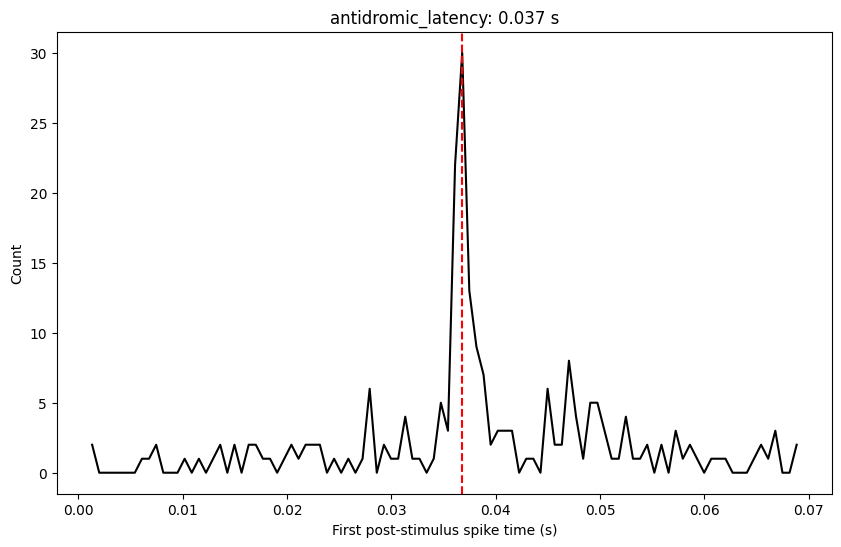

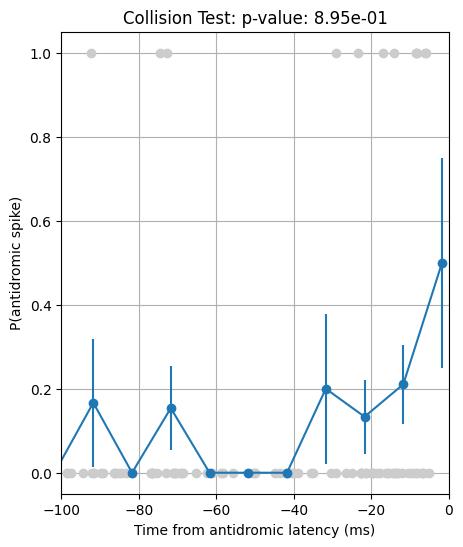

In [45]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

# --- Assume you already have these ---
# all_spike_times = np.concatenate(ROI_sorted_data)
# antidromic_latency (scalar, in seconds)
# antidromic_jitter = 0.005

# Step 1: Preprocessing
num_trials = len(ROI_sorted_data)
last_ortho_spike_times = np.full(num_trials, np.nan)
collision_flags = np.ones(num_trials, dtype=int)  # Start assuming collision (=1), change later if antidromic spike exists

# antidromic analysis
# ROI_sorted_data = sorted_data 
first_post_stim_spike_times = []
all_spike_times = np.concatenate(ROI_sorted_data)

# sorted_data
for a, spike_times in enumerate(ROI_sorted_data):
    if spike_times.size > 0 and any(spike_times[spike_times > 0]):       
        first_post_stim_spike_times.append(spike_times[spike_times > 0][0])

print(first_post_stim_spike_times)
hist, bin_edges = np.histogram(first_post_stim_spike_times, bins=100)
# plot histogram
plt.figure(figsize=(10, 6))
plt.plot(bin_edges[:-1], hist, color='k')
plt.xlabel('First post-stimulus spike time (s)')
plt.ylabel('Count')
# find x-value for the peak 
peak_x = bin_edges[np.argmax(hist)]
antidromic_latency = peak_x
plt.axvline(peak_x, color='r', linestyle='--')
plt.title(f'antidromic_latency: {peak_x:.3f} s') 




# Step 2: Vectorized processing
for i, spike_times in enumerate(ROI_sorted_data):
    if spike_times.size == 0:
        continue
    
    ortho_mask = spike_times <= (antidromic_latency - antidromic_jitter)
    anti_mask = (antidromic_latency - antidromic_jitter < spike_times) & (spike_times < antidromic_latency + antidromic_jitter)
    
    ortho_spikes = spike_times[ortho_mask]
    anti_spikes = spike_times[anti_mask]
    
    if ortho_spikes.size > 0:
        last_ortho_spike_times[i] = ortho_spikes[-1]  # Only keep the last orthodromic spike
    
    if anti_spikes.size > 0:
        collision_flags[i] = 0  # If antidromic spike exists, collision = 0 (no collision)

# Step 3: Assemble DataFrame
antidromic_df = pd.DataFrame({
    'trial_num': np.arange(num_trials),
    'last_orthodromic_spike_time': last_ortho_spike_times,
    'collision': collision_flags
})

# Step 4: ROI selection and plot
roi_df = antidromic_df.dropna(subset=['last_orthodromic_spike_time'])  # Keep only trials with orthodromic spikes

x = (roi_df['last_orthodromic_spike_time'].values - antidromic_latency) * 1000  # in ms
y = 1 - roi_df['collision'].values  # 1 = successful antidromic spike, 0 = collision

from scipy.stats import mannwhitneyu
# Define windows (you can adjust these)
early_window = (-100, -70)  # in ms
near_latency_window = (-30, 0)

# Select data in each window
early_indices = (x >= early_window[0]) & (x < early_window[1])
near_latency_indices = (x >= near_latency_window[0]) & (x <= near_latency_window[1])

early_probs = y[early_indices]
near_latency_probs = y[near_latency_indices]

# Perform Mann-Whitney U test
statistic, p_value = mannwhitneyu(early_probs, near_latency_probs, alternative='greater')

print(f"Mann-Whitney U test statistic: {statistic:.4f}")


# Interpretation
if p_value < 0.05:
    print("P(antidromic spike) is significantly lower near antidromic latency (p < 0.05).")
else:
    print("No significant decrease in P(antidromic spike) near antidromic latency.")

# Scatter plot
plt.figure(figsize=(5, 6))
plt.plot(x, y, 'o', color=[0.8, 0.8, 0.8], label='Antidromic spikes')

# Bin averages
def Avg_y_over_x(x, y, bin_size):
    edges = np.arange(np.min(x), np.max(x) + bin_size, bin_size)
    x_idx = np.digitize(x, edges) - 1
    bin_centers = (edges[:-1] + edges[1:]) / 2
    avg_y = np.full_like(bin_centers, np.nan, dtype=np.float64)
    sem_y = np.full_like(bin_centers, np.nan, dtype=np.float64)
    
    for i in range(len(bin_centers)):
        bin_y = y[x_idx == i]
        if bin_y.size > 0:
            avg_y[i] = np.nanmean(bin_y)
            sem_y[i] = np.nanstd(bin_y) / np.sqrt(bin_y.size)
    
    avg_df = pd.DataFrame({'x': bin_centers, 'y': avg_y, 'sem': sem_y})
    return avg_df, edges

# Plot binned averages
result, edges = Avg_y_over_x(x, y, bin_size=10)
plt.errorbar(result['x'], result['y'], yerr=result['sem'], fmt='o-', label='Average ± SEM')
plt.xlabel('Time from antidromic latency (ms)')
plt.ylabel('P(antidromic spike)')
plt.title(f'Collision Test: p-value: {p_value:.2e}')  # <- use f-string
plt.xlim([-100, 0])
plt.ylim([-0.05, 1.05])
# plt.legend()
plt.grid(True)
plt.show()

# print('Bin edges:', edges)

# plt.figure(figsize=(6, 4))
# plt.boxplot([early_probs, near_latency_probs], labels=['Early (-100 to -70 ms)', 'Near Latency (-30 to 0 ms)'])
# plt.ylabel('P(antidromic spike)')
# plt.title(f'Statistical Test\np = {p_value:.4e}')
# plt.grid(True)
# plt.show()


Mann-Whitney U test statistic: 1494.0000
P-value: 1.1482e-10
P(antidromic spike) is significantly lower near antidromic latency (p < 0.05).


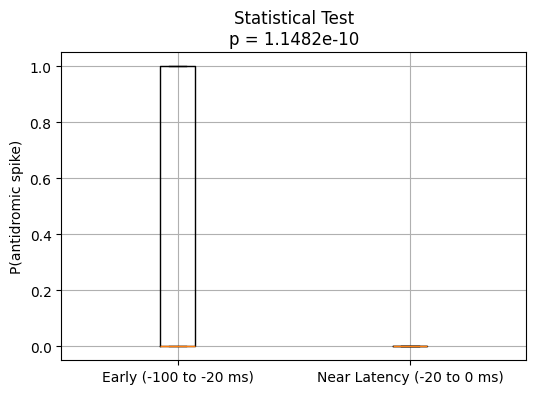

In [ ]:
## No figure, code collision test
result_folder = '/scratch/antidromic'
# Load the session summary CSV file
session_summary_path = os.path.join(result_folder, 'session_summary.csv')
session_summary_df = pd.read_csv(session_summary_path)
from scipy.stats import wilcoxon

def opto_tagging_response(int_event_locked_timestamps, base_window, roi_window):
    base_counts = []
    roi_counts = []

    for spike_times in int_event_locked_timestamps:
        if spike_times.size > 0:
            base_count = np.sum((spike_times >= base_window[0]) & (spike_times < base_window[1]))
            roi_count = np.sum((spike_times >= roi_window[0]) & (spike_times < roi_window[1]))
            base_counts.append(base_count)
            roi_counts.append(roi_count)

    base_counts = np.array(base_counts)
    roi_counts = np.array(roi_counts)

    # ✅ Only run test if we have at least 2 samples
    if len(base_counts) >= 2 and len(roi_counts) >= 2:
        try:
            stat, p_value = wilcoxon(base_counts, roi_counts)
            return p_value
        except ValueError:
            return np.nan
    else:
        return np.nan

    
def plot_opto_responses(unit_tbl, event_ids, spiketimes, session_id):
    results = []

    # Filter for opto tagged units
    opto_criteria = (unit_tbl['opto_pass'] == True) & (unit_tbl['default_qc'] == True)
    opto_units = unit_tbl[opto_criteria]["unit_id"].to_list()
    print(f"Session {session_id}: {len(opto_units)} opto-tagged units")

    
    # Unique values
    sites = list(np.unique(event_ids.emission_location))
    powers = list(np.unique(event_ids.power))
    trial_types = np.unique(event_ids.type)
    
    # Settings
    prepost = 'post'
    num_sites = len(sites)
    num_units = len(opto_units)

   
    # Loop through units
    for u_idx, unit_id in enumerate(opto_units):
        # if unit_id == 244:
        unit_spike_times = spiketimes[unit_id]

        for i, site in enumerate(sites):
            base_window = (-0.02, 0)
            roi_window = (0, 0.02) if site == 'surface_LC' else (0.03, 0.05)


            # Filter trials
            tag_trials = event_ids.query('site == @site and pre_post == @prepost')
            max_power = tag_trials.power.max()
            tag_trials = tag_trials.query('power == @max_power')
            if tag_trials.empty:
                continue

            # Stimulation parameters
            duration = np.unique(tag_trials.duration)[0]
            num_pulses = np.unique(tag_trials.num_pulses)[0]
            pulse_interval = np.unique(tag_trials.pulse_interval)[0]

            # Time window
            time_range_raster = np.array([-100 / 1000, 70 / 1000])
            this_event_timestamps = tag_trials.time.tolist()

            int_event_locked_timestamps = []
            pulse_nums = []

            for pulse_num in range(num_pulses):
                time_shift = pulse_num * (duration + pulse_interval) / 1000
                this_time_range = time_range_raster + time_shift

                this_locked = af.event_locked_timestamps(
                    unit_spike_times, this_event_timestamps, this_time_range, time_shift=time_shift
                )
                int_event_locked_timestamps.extend(this_locked)
                pulse_nums.extend([pulse_num + 1] * len(this_locked))

            # Perform significance test
            if len(int_event_locked_timestamps) != 0:
                p_val = opto_tagging_response(int_event_locked_timestamps, base_window, roi_window)
            if not np.isnan(p_val):
                results.append({
                    'unit_id': unit_id,
                    'site': site,
                    'p_value': round(p_val, 3)
                })
    return results



# ---- Main loop: compute opto response stats ----
all_opto_stats = []
session_summary_df['opto_units'] = None


for index, row in session_summary_df.iterrows():
    session = row['session']
    session_id = row['session_id']
    session_path = row['session_path']
    summary_file_path = row['summary_file_path']
    summary_exists = row['summary_exists']
    opto_session_file_path = row['opto_session_file_path'] 
    opto_session_exists = row['opto_session_exists']               
    spiketimes_file_path = row['spiketimes_file_path']
    spiketimes_exists = row['spiketimes_exists']

    if summary_exists and opto_session_exists and spiketimes_exists:
        print(f"Processing session: {session}")
        # Load the summary file
        unit_tbl = pd.read_pickle(summary_file_path)
        # print(f"Loaded summary file for {session}")
        # Load the opto session file
        event_ids = pd.read_csv(opto_session_file_path)
        # print(f"Loaded opto session file for {session}")
        # Load the spiketimes file
        with open(spiketimes_file_path, 'rb') as f:
            spiketimes = pickle.load(f)        

        # Filter for opto tagged units
        opto_criteria = (unit_tbl['opto_pass'] == True) & (unit_tbl['default_qc'] == True)
        opto_units = unit_tbl[opto_criteria]["unit_id"].to_list()
        # add opto_units to session_summary_df
        session_summary_df.at[index, 'opto_units'] = opto_units

        # Collect per-session result
        opto_stats = plot_opto_responses(unit_tbl, event_ids, spiketimes, session_id)
        all_opto_stats.append(opto_stats)
    else:
        all_opto_stats.append([])  # For missing files, add empty list

# Add full stats to DataFrame
session_summary_df['opto_unit_stats'] = all_opto_stats

from collections import defaultdict

# First, get all unique site names across all sessions
all_sites = set()
for stats in all_opto_stats:
    for entry in stats:
        all_sites.add(entry['site'])

# Initialize new columns in the DataFrame
for site in all_sites:
    col_name = f"sig_units_{site}"
    session_summary_df[col_name] = [[] for _ in range(len(session_summary_df))]

# Populate those columns with unit_ids that have p < 0.05
for i, stats in enumerate(session_summary_df['opto_unit_stats']):
    site_to_units = defaultdict(list)
    for entry in stats:
        if entry['p_value'] < 0.05:
            site_to_units[entry['site']].append(entry['unit_id'])

    # Assign to columns
    for site in all_sites:
        col_name = f"sig_units_{site}"
        session_summary_df.at[i, col_name] = site_to_units.get(site, [])

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

# --- Assume you already have these ---
# all_spike_times = np.concatenate(ROI_sorted_data)
# antidromic_latency (scalar, in seconds)
# antidromic_jitter = 0.005

# Step 1: Preprocessing
num_trials = len(ROI_sorted_data)
last_ortho_spike_times = np.full(num_trials, np.nan)
collision_flags = np.ones(num_trials, dtype=int)  # Start assuming collision (=1), change later if antidromic spike exists

# antidromic analysis
# ROI_sorted_data = sorted_data 
first_post_stim_spike_times = []
all_spike_times = np.concatenate(ROI_sorted_data)

# sorted_data
for a, spike_times in enumerate(ROI_sorted_data):
    if spike_times.size > 0 and any(spike_times[spike_times > 0]):       
        first_post_stim_spike_times.append(spike_times[spike_times > 0][0])

print(first_post_stim_spike_times)
hist, bin_edges = np.histogram(first_post_stim_spike_times, bins=100)
# plot histogram
plt.figure(figsize=(10, 6))
plt.plot(bin_edges[:-1], hist, color='k')
plt.xlabel('First post-stimulus spike time (s)')
plt.ylabel('Count')
# find x-value for the peak 
peak_x = bin_edges[np.argmax(hist)]
antidromic_latency = peak_x
plt.axvline(peak_x, color='r', linestyle='--')
plt.title(f'antidromic_latency: {peak_x:.3f} s') 

# Step 2: Vectorized processing
for i, spike_times in enumerate(ROI_sorted_data):
    if spike_times.size == 0:
        continue
    
    ortho_mask = spike_times <= (antidromic_latency - antidromic_jitter)
    anti_mask = (antidromic_latency - antidromic_jitter < spike_times) & (spike_times < antidromic_latency + antidromic_jitter)
    
    ortho_spikes = spike_times[ortho_mask]
    anti_spikes = spike_times[anti_mask]
    
    if ortho_spikes.size > 0:
        last_ortho_spike_times[i] = ortho_spikes[-1]  # Only keep the last orthodromic spike
    
    if anti_spikes.size > 0:
        collision_flags[i] = 0  # If antidromic spike exists, collision = 0 (no collision)

# Step 3: Assemble DataFrame
antidromic_df = pd.DataFrame({
    'trial_num': np.arange(num_trials),
    'last_orthodromic_spike_time': last_ortho_spike_times,
    'collision': collision_flags
})

# Step 4: ROI selection and plot
roi_df = antidromic_df.dropna(subset=['last_orthodromic_spike_time'])  # Keep only trials with orthodromic spikes

x = (roi_df['last_orthodromic_spike_time'].values - antidromic_latency) * 1000  # in ms
y = 1 - roi_df['collision'].values  # 1 = successful antidromic spike, 0 = collision

from scipy.stats import mannwhitneyu
# Define windows (you can adjust these)
early_window = (-100, -70)  # in ms
near_latency_window = (-30, 0)

# Select data in each window
early_indices = (x >= early_window[0]) & (x < early_window[1])
near_latency_indices = (x >= near_latency_window[0]) & (x <= near_latency_window[1])

early_probs = y[early_indices]
near_latency_probs = y[near_latency_indices]

# Perform Mann-Whitney U test
statistic, p_value = mannwhitneyu(early_probs, near_latency_probs, alternative='greater')

print(f"Mann-Whitney U test statistic: {statistic:.4f}")


# Interpretation
if p_value < 0.05:
    print("P(antidromic spike) is significantly lower near antidromic latency (p < 0.05).")
else:
    print("No significant decrease in P(antidromic spike) near antidromic latency.")

# Scatter plot
plt.figure(figsize=(5, 6))
plt.plot(x, y, 'o', color=[0.8, 0.8, 0.8], label='Antidromic spikes')

# Bin averages
def Avg_y_over_x(x, y, bin_size):
    edges = np.arange(np.min(x), np.max(x) + bin_size, bin_size)
    x_idx = np.digitize(x, edges) - 1
    bin_centers = (edges[:-1] + edges[1:]) / 2
    avg_y = np.full_like(bin_centers, np.nan, dtype=np.float64)
    sem_y = np.full_like(bin_centers, np.nan, dtype=np.float64)
    
    for i in range(len(bin_centers)):
        bin_y = y[x_idx == i]
        if bin_y.size > 0:
            avg_y[i] = np.nanmean(bin_y)
            sem_y[i] = np.nanstd(bin_y) / np.sqrt(bin_y.size)
    
    avg_df = pd.DataFrame({'x': bin_centers, 'y': avg_y, 'sem': sem_y})
    return avg_df, edges

# Plot binned averages
result, edges = Avg_y_over_x(x, y, bin_size=10)
plt.errorbar(result['x'], result['y'], yerr=result['sem'], fmt='o-', label='Average ± SEM')
plt.xlabel('Time from antidromic latency (ms)')
plt.ylabel('P(antidromic spike)')
plt.title(f'Collision Test: p-value: {p_value:.2e}')  # <- use f-string
plt.xlim([-100, 0])
plt.ylim([-0.05, 1.05])
# plt.legend()
plt.grid(True)
plt.show()

# print('Bin edges:', edges)

# plt.figure(figsize=(6, 4))
# plt.boxplot([early_probs, near_latency_probs], labels=['Early (-100 to -70 ms)', 'Near Latency (-30 to 0 ms)'])
# plt.ylabel('P(antidromic spike)')
# plt.title(f'Statistical Test\np = {p_value:.4e}')
# plt.grid(True)
# plt.show()


In [ ]:
## Old antidromic analysis
ROI_session = ['behavior_751181_2025-02-27_11-24-47']
for session in folders:
    if session in ROI_session:        
        if session in processed_session_id:
            print(f'{session} already processed')        
        else:
            subject_id = session.split('_')[1]
            print("subject id: ", subject_id)
            print("session: ", session)
            # session_dir = session_dirs(session)
                        
            # load opto tagging data
            data_type = 'curated'
            target = 'soma'


            data_folder = f'{scratch_data_folder}/{subject_id}/{session}/ephys/opto/curated'
            print("Loading opto tagging data")

            try: 
                with open(os.path.join(data_folder, f'{session}_curated_soma_opto_tagging_summary.pkl'), 'rb') as f:            
                    unit_tbl = pickle.load(f)
            except Exception as e:
                print(f"Skipping {os.path.join(data_folder, f'{session}_curated_soma_opto_tagging_summary.pkl')} due to error: {e}")
                continue
            
            opto_units = unit_tbl.query("opto_pass == True & default_qc == True")["unit_id"].to_list()
            print("opto_units: ", opto_units)
            ## Load spike times

            print("Loading spiketimes")
            # session_dir = session_dirs(session)
            data_type = 'curated'

            try:
                with open(os.path.join(f'{scratch_data_folder}/{subject_id}/{session}/ephys/curated/processed', 'spiketimes.pkl'), 'rb') as f:
                    spiketimes = pickle.load(f)
            except Exception as e:
                print(f"Skipping {os.path.join(data_folder, 'spiketimes.pkl')} due to error: {e}")
                continue

            start = np.min(np.array([np.min(spiketimes[unit]) for unit in spiketimes.keys()]))
            end = np.max(np.array([np.max(spiketimes[unit]) for unit in spiketimes.keys()]))
            # Load opto event data
            opto_event_file = Path(f'{data_folder}/{session}_opto_session.csv')
            event_ids = pd.read_csv(opto_event_file)

            # Unique values
            sites = list(np.unique(event_ids.emission_location))
            powers = list(np.unique(event_ids.power))
            trial_types = np.unique(event_ids.type)

            opto_units = opto_units  # Limit to first 2 units for demonstration
            # Settings
            prepost = 'post'
            num_sites = len(sites)
            num_units = len(opto_units)

            # Create one figure for all units × sites (3 rows per unit: raster + PSTH + antidromic raster)
            fig_height_per_unit = 6
            fig = plt.figure(figsize=(num_sites * 4, num_units * fig_height_per_unit))
            fig.suptitle(f'{session} - Opto responses for {num_units} units', fontsize=16)
            gs = gridspec.GridSpec(4 * num_units, num_sites, height_ratios=[3, 6, 2, 0.5] * num_units, hspace=0.8)

            # Loop through units
            for u_idx, unit_id in enumerate(opto_units):
                if unit_id == 244:
                    unit_spike_times = spiketimes[unit_id]

                    for i, site in enumerate(sites):
                        # Filter trials
                        tag_trials = event_ids.query('site == @site and pre_post == @prepost')
                        max_power = tag_trials.power.max()
                        tag_trials = tag_trials.query('power == @max_power')
                        if tag_trials.empty:
                            continue

                        # Stimulation parameters
                        duration = np.unique(tag_trials.duration)[0]
                        num_pulses = np.unique(tag_trials.num_pulses)[0]
                        pulse_interval = np.unique(tag_trials.pulse_interval)[0]

                        # Time window
                        time_range_raster = np.array([-150 / 1000, 70 / 1000])
                        this_event_timestamps = tag_trials.time.tolist()

                        int_event_locked_timestamps = []
                        pulse_nums = []

                        for pulse_num in range(num_pulses):
                            time_shift = pulse_num * (duration + pulse_interval) / 1000
                            this_time_range = time_range_raster + time_shift

                            this_locked = af.event_locked_timestamps(
                                unit_spike_times, this_event_timestamps, this_time_range, time_shift=time_shift
                            )
                            int_event_locked_timestamps.extend(this_locked)
                            pulse_nums.extend([pulse_num + 1] * len(this_locked))

                        # Raster plot
                        ax_raster = fig.add_subplot(gs[4 * u_idx, i])
                        pf.raster_plot(int_event_locked_timestamps, time_range_raster, cond_each_trial=pulse_nums, ms=100, ax=ax_raster)

                        # Add laser pulse patch
                        yLims = np.array(ax_raster.get_ylim())
                        laser_color = 'tomato'
                        rect = patches.Rectangle((0, yLims[0]), duration / 1000, yLims[1] - yLims[0],
                                                linewidth=1, edgecolor=laser_color, facecolor=laser_color,
                                                alpha=0.2, clip_on=True)
                        ax_raster.add_patch(rect)

                        # Raster axis settings
                        if i == 0:
                            ax_raster.set_ylabel(f'Unit {unit_id}\nPulse #')
                        else:
                            ax_raster.set_yticklabels([])

                        ax_raster.set_xlim(time_range_raster)
                        if u_idx == num_units - 1:
                            ax_raster.set_xlabel('Time (s)')
                        ax_raster.set_title(f'{site}, {max_power} mW')


                        # Add laser pulse aligned but sorted by spike times
                        # Antidromic raster plot
                        ax_antidromic = fig.add_subplot(gs[4 * u_idx + 1, i], sharex=ax_raster)
                        sorted_data = sorted(int_event_locked_timestamps, key=lambda x: (len(x) == 0, x[0] if len(x) > 0 else np.inf))
                        if i == 2:
                            ROI_sorted_data = sorted_data
                        pf.raster_plot(sorted_data, time_range_raster)
                        # pf.raster_plot(sorted_data, time_range_raster, ax=ax_antidromic)

                        yLims = np.array(ax_antidromic.get_ylim())
                        rect = patches.Rectangle((0, yLims[0]), duration / 1000, yLims[1] - yLims[0],
                                                linewidth=1, edgecolor='tomato', facecolor='tomato',
                                                alpha=0.2, clip_on=False)
                        ax_antidromic.add_patch(rect)

                        ax_antidromic.set_xlim(time_range_raster)
                        if u_idx == num_units - 1:
                            ax_antidromic.set_xlabel('Time (s)')

                        if i == 0:
                            ax_antidromic.set_ylabel('Sorted Trials')
                        else:
                            ax_antidromic.set_yticklabels([])

                        # PSTH plot
                        ax_psth = fig.add_subplot(gs[4 * u_idx + 2, i], sharex=ax_raster)
                        psth, _, bins = pf.psth(int_event_locked_timestamps, time_range_raster, bin_size=0.003, smooth_window_size=3)
                        ax_psth.plot(bins, psth, color='k')
                        if i == 0:
                            ax_psth.set_ylabel('PSTH')
                        else:
                            ax_psth.set_yticklabels([])
                        ax_psth.set_xlim(time_range_raster)
                        if u_idx == num_units - 1:
                            ax_psth.set_xlabel('Time (s)')
                        

                        

            # Final layout adjustments
            # fig.tight_layout(rect=[0, 0.03, 1, 0.95])
        
            # # Save figure as pdf
            # fig.savefig(os.path.join(result_folder, f'{session}_antidromic_raster_summary.pdf'), bbox_inches='tight')   
            # print(f'Saved figure to {result_folder}/{session}_antidromic_raster_summary.pdf')     

behavior_716325_2024-05-31_10-31-14 already processed
behavior_717121_2024-06-15_10-00-58 already processed
behavior_751766_2025-02-13_11-31-21 already processed
behavior_751766_2025-02-11_11-53-38 already processed
behavior_751766_2025-02-14_11-37-11 already processed
behavior_751766_2025-02-15_12-08-11
Skipping /data/LC-NE_scratch_data/751766/behavior_751766_2025-02-15_12-08-11/ephys/opto/curated/behavior_751766_2025-02-15_12-08-11_curated_soma_opto_tagging_summary.pkl due to error: [Errno 2] No such file or directory: '/data/LC-NE_scratch_data/751766/behavior_751766_2025-02-15_12-08-11/ephys/opto/curated/behavior_751766_2025-02-15_12-08-11_curated_soma_opto_tagging_summary.pkl'
behavior_754897_2025-03-12_12-23-15 already processed
behavior_754897_2025-03-11_12-07-41 already processed
behavior_754897_2025-03-14_11-28-53 already processed
behavior_754897_2025-03-13_11-20-42 already processed
behavior_754897_2025-03-15_11-32-18
Skipping /data/LC-NE_scratch_data/754897/behavior_754897_2

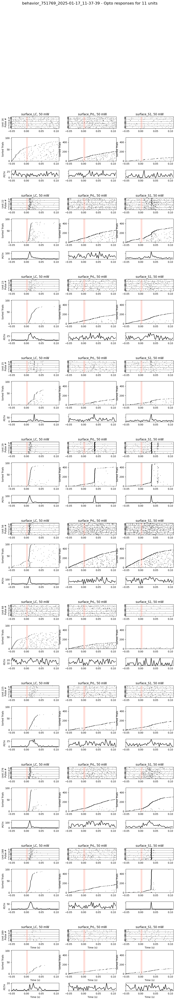

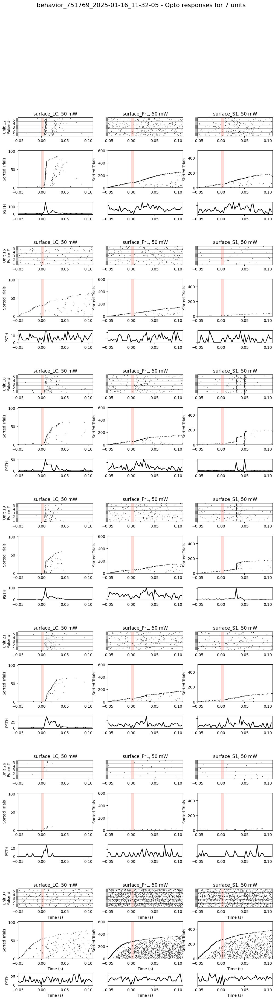

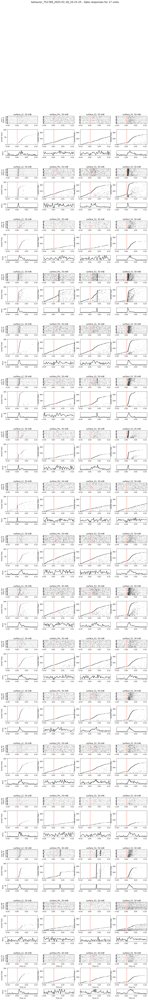

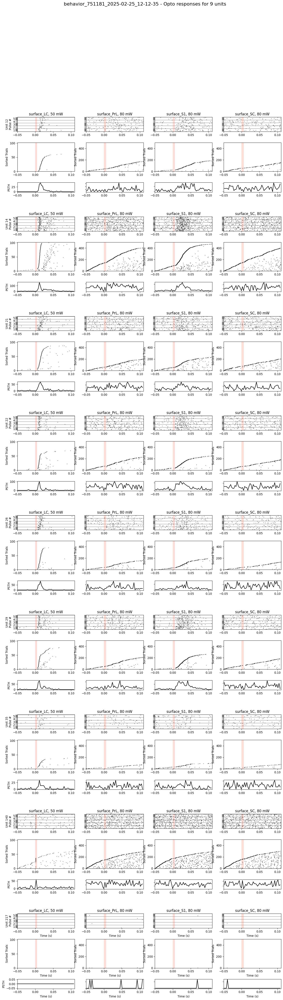

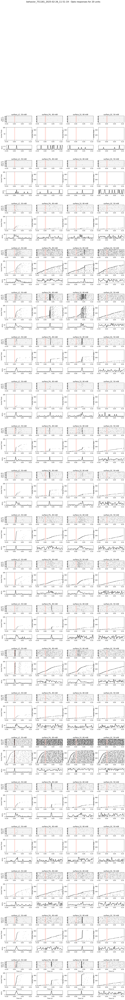

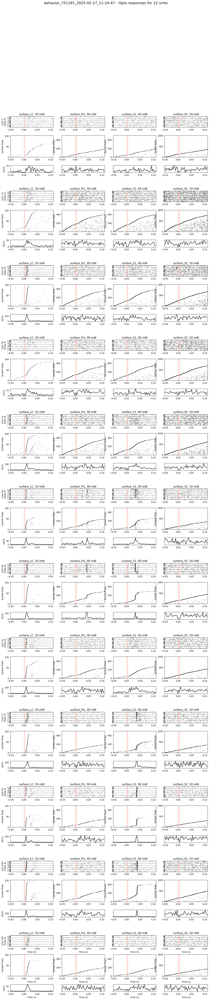

In [4]:
for session in folders:
    if session in processed_session_id:
        print(f'{session} already processed')        
    else:
        subject_id = session.split('_')[1]
        print(session)
        # session_dir = session_dirs(session)
        data_type = 'curated'
        target = 'soma'

        data_folder = f'/data/LC-NE_scratch_data/{subject_id}/{session}/ephys/opto/curated'
        # load opto tagging data
        try: 
            with open(os.path.join(data_folder, f'{session}_curated_soma_opto_tagging_summary.pkl'), 'rb') as f:            
                unit_tbl = pickle.load(f)
        except Exception as e:
            print(f"Skipping {os.path.join(data_folder, f'{session}_curated_soma_opto_tagging_summary.pkl')} due to error: {e}")
            continue
        opto_units = unit_tbl.query("opto_pass == True & default_qc == True")["unit_id"].to_list()
        print(opto_units)
        ## Load spike times
        # session_dir = session_dirs(session)
        data_type = 'curated'

        try:
            with open(os.path.join(f'/data/LC-NE_scratch_data/{subject_id}/{session}/ephys/curated/processed', 'spiketimes.pkl'), 'rb') as f:
                spiketimes = pickle.load(f)
        except Exception as e:
            print(f"Skipping {os.path.join(data_folder, 'spiketimes.pkl')} due to error: {e}")
            continue
        start = np.min(np.array([np.min(spiketimes[unit]) for unit in spiketimes.keys()]))
        end = np.max(np.array([np.max(spiketimes[unit]) for unit in spiketimes.keys()]))
        # Load opto event data
        opto_event_file = Path(f'{data_folder}/{session}_opto_session.csv')
        event_ids = pd.read_csv(opto_event_file)

        # Unique values
        sites = list(np.unique(event_ids.emission_location))
        powers = list(np.unique(event_ids.power))
        trial_types = np.unique(event_ids.type)

        opto_units = opto_units  # Limit to first 2 units for demonstration
        # Settings
        prepost = 'post'
        num_sites = len(sites)
        num_units = len(opto_units)

        # Create one figure for all units × sites (3 rows per unit: raster + PSTH + antidromic raster)
        fig_height_per_unit = 6
        fig = plt.figure(figsize=(num_sites * 4, num_units * fig_height_per_unit))
        fig.suptitle(f'{session} - Opto responses for {num_units} units', fontsize=16)
        gs = gridspec.GridSpec(4 * num_units, num_sites, height_ratios=[3, 6, 2, 0.5] * num_units, hspace=0.8)

        # Loop through units
        for u_idx, unit_id in enumerate(opto_units):
            unit_spike_times = spiketimes[unit_id]

            for i, site in enumerate(sites):
                # Filter trials
                tag_trials = event_ids.query('site == @site and pre_post == @prepost')
                max_power = tag_trials.power.max()
                tag_trials = tag_trials.query('power == @max_power')
                if tag_trials.empty:
                    continue

                # Stimulation parameters
                duration = np.unique(tag_trials.duration)[0]
                num_pulses = np.unique(tag_trials.num_pulses)[0]
                pulse_interval = np.unique(tag_trials.pulse_interval)[0]

                # Time window
                time_range_raster = np.array([-50 / 1000, 110 / 1000])
                this_event_timestamps = tag_trials.time.tolist()

                int_event_locked_timestamps = []
                pulse_nums = []

                for pulse_num in range(num_pulses):
                    time_shift = pulse_num * (duration + pulse_interval) / 1000
                    this_time_range = time_range_raster + time_shift

                    this_locked = af.event_locked_timestamps(
                        unit_spike_times, this_event_timestamps, this_time_range, time_shift=time_shift
                    )
                    int_event_locked_timestamps.extend(this_locked)
                    pulse_nums.extend([pulse_num + 1] * len(this_locked))

                # Raster plot
                ax_raster = fig.add_subplot(gs[4 * u_idx, i])
                pf.raster_plot(int_event_locked_timestamps, time_range_raster, cond_each_trial=pulse_nums, ms=100, ax=ax_raster)

                # Add laser pulse patch
                yLims = np.array(ax_raster.get_ylim())
                laser_color = 'tomato'
                rect = patches.Rectangle((0, yLims[0]), duration / 1000, yLims[1] - yLims[0],
                                        linewidth=1, edgecolor=laser_color, facecolor=laser_color,
                                        alpha=0.2, clip_on=True)
                ax_raster.add_patch(rect)

                # Raster axis settings
                if i == 0:
                    ax_raster.set_ylabel(f'Unit {unit_id}\nPulse #')
                else:
                    ax_raster.set_yticklabels([])
                ax_raster.set_xlim(time_range_raster)
                if u_idx == num_units - 1:
                    ax_raster.set_xlabel('Time (s)')
                ax_raster.set_title(f'{site}, {max_power} mW')


                # Add laser pulse aligned but sorted by spike times
                # Antidromic raster plot
                ax_antidromic = fig.add_subplot(gs[4 * u_idx + 1, i], sharex=ax_raster)
                sorted_data = sorted(int_event_locked_timestamps, key=lambda x: (len(x) == 0, x[0] if len(x) > 0 else np.inf))
                pf.raster_plot(sorted_data, time_range_raster)
                # pf.raster_plot(sorted_data, time_range_raster, ax=ax_antidromic)

                yLims = np.array(ax_antidromic.get_ylim())
                rect = patches.Rectangle((0, yLims[0]), duration / 1000, yLims[1] - yLims[0],
                                        linewidth=1, edgecolor='tomato', facecolor='tomato',
                                        alpha=0.2, clip_on=False)
                ax_antidromic.add_patch(rect)

                ax_antidromic.set_ylabel('Sorted Trials')
                ax_antidromic.set_xlim(time_range_raster)
                if u_idx == num_units - 1:
                    ax_antidromic.set_xlabel('Time (s)')

                # PSTH plot
                ax_psth = fig.add_subplot(gs[4 * u_idx + 2, i], sharex=ax_raster)
                psth, _, bins = pf.psth(int_event_locked_timestamps, time_range_raster, bin_size=0.003, smooth_window_size=3)
                ax_psth.plot(bins, psth, color='k')
                if i == 0:
                    ax_psth.set_ylabel('PSTH')
                else:
                    ax_psth.set_yticklabels([])
                ax_psth.set_xlim(time_range_raster)
                if u_idx == num_units - 1:
                    ax_psth.set_xlabel('Time (s)')

        # Final layout adjustments
        fig.tight_layout(rect=[0, 0.03, 1, 0.95])
    
        # Save figure as pdf
        fig.savefig(os.path.join(result_folder, f'{session}_antidromic_raster_summary.pdf'), bbox_inches='tight')   
        print(f'Saved figure to {result_folder}/{session}_antidromic_raster_summary.pdf')     
